In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
from tqdm import tqdm
import copy
import matplotlib.pyplot as plt
from matplotlib import cm
import torch
import torch.nn as nn
from torch.optim.lr_scheduler import StepLR
import albumentations as A
import random
from torch.utils.data import DataLoader

In [3]:
from pathml.datasets.pannuke import PanNukeDataModule
from pathml.ml.hovernet import HoVerNet, loss_hovernet, post_process_batch_hovernet, _HoverNetDecoder
from pathml.ml.utils import wrap_transform_multichannel, dice_score
from pathml.utils import plot_segmentation
from pathml.ml.hovernet import _dice_loss_nc_head, _ce_loss_nc_head

from mc_lightning.models.resnet.resnet_dataset import SlideDataset
from mc_lightning.models.resnet.resnet_transforms import RGBTrainTransform, RGBEvalTransform

In [4]:
import sys
sys.path.append('./image-graphs/')

from hovernet_weak_finetuning import get_pseudomask, get_pseudomask_noise
from nuclei_processing import process_slide

In [5]:
import matplotlib
rgb_pal = [matplotlib.colors.BASE_COLORS['r'], matplotlib.colors.BASE_COLORS['g'], matplotlib.colors.BASE_COLORS['b']]

In [6]:
import seaborn as sns
def set_rc(x=10,y=10, font_scale=1.):
    sns.set(rc={'figure.figsize':[x,y]}, font_scale=font_scale)

from PIL import Image

def pil_loader(path):
    # open path as file to avoid ResourceWarning (https://github.com/python-pillow/Pillow/issues/835)
    with open(path, 'rb') as f:
        img = Image.open(f)
        return img.convert('RGB')

def get_example(path):
    x = np.asarray(pil_loader(path))[128:256+128, 128:256+128]
    return x 

import pandas as pd
def get_merged_df(df1, df2, drop_col=None):
    merge = df1.merge(df2, how='left', left_index=True, right_index=True)
    if drop_col is not None:
        merge = merge.dropna(subset=[drop_col])
    return merge

In [7]:
paths = pd.read_csv('/mnt/disks/image_data/kidney/20201117_inferred_tvnt_g2_vs_g4_all_profile_rcc_fixed_histoqc_masks.csv')
anno = pd.read_csv('./profile_rcc_data_anno_updated_20200114.csv', index_col=[0])

paths['file_id'] = paths['full_path'].apply(lambda x: x.split('/')[-3].split('_files')[0])
paths = get_merged_df(paths.set_index('file_id'), anno[['histology_types']])


paths = paths.loc[paths.histology_types == 'Clear cell']

- Note that of the 36 pixel annotation examples we have, 19 are clear cell

In [8]:
print(paths.shape)
pixel_anno_ids = pd.read_csv('./profile_rcc_all_tvnt_pixel_anno_ids.csv').iloc[:,1].values
overlapping_pixel_anno_ids = [x for x in pixel_anno_ids if x in paths.index.values]
print(f'dropping {len(overlapping_pixel_anno_ids)} slides with pixel level annotations (a portion of which used for TvNT classifier training)')

paths = paths.drop(labels=overlapping_pixel_anno_ids)
print(paths.shape)

print('Using original splitting scheme')
high_ptumor = paths.loc[paths.prob_tumor > 0.8]
low_ptumor = paths.loc[paths.prob_tumor < 0.2]

(894818, 7)
dropping 19 slides with pixel level annotations (a portion of which used for TvNT classifier training)
(823606, 7)
Using original splitting scheme


In [9]:
anno.loc[pixel_anno_ids].groupby('histology_types').count().iloc[:,1]

histology_types
Chromophobe         4
Clear cell         19
Oncocytic RCC       1
Papillary           5
Unclassified        3
Name: UNIQUE_SAMPLE_ID, dtype: int64

### Streamline above for a dataloader setup with GPU 

In [79]:
# load the best model
checkpoint = torch.load("/mnt/disks/image_data/kidney/hover/hovernet_pannuke.pt", map_location='cpu')
n_classes_pannuke = 6

# load the model
hovernet = HoVerNet(n_classes=n_classes_pannuke)
hovernet = torch.nn.DataParallel(hovernet)
hovernet.load_state_dict(checkpoint)
hovernet = hovernet.module
hovernet.to('cuda');

In [80]:
HEAD_ONLY = True
if HEAD_ONLY:
    print('only tuning a FC head layer')
    
# ALTERNATIVE: start with pretrained NC 
if not HEAD_ONLY:
    nc_branch_pretrain_clone = copy.deepcopy(hovernet.nc_branch)
    new_decoder = nc_branch_pretrain_clone
    new_decoder.to('cuda')

# create new head layer to push NC to 3 classes 
decoder_post_fc = nn.Conv2d(in_channels = 64, out_channels = 3, kernel_size = 1)
decoder_post_fc.to('cuda');

only tuning a FC head layer


In [81]:
low_ptumor_subset_ids = pd.Series(low_ptumor.index.unique()).sample(25)

high_ptumor_subset_ids = pd.Series(high_ptumor.index.unique()).sample(25)

subset = paths.loc[list(low_ptumor_subset_ids) + list(high_ptumor_subset_ids)]

TPS = 250
SUBSAMPLE_SIZE = 1000
# SUBSAMPLE_SIZE = 3000
balanced_subset = subset.groupby('file_id').apply(lambda x: x.sample(min(len(x), TPS))).reset_index(0, drop=True)
balanced_subset = balanced_subset.sample(SUBSAMPLE_SIZE)

# paths_nonsubset = paths.drop(list(subset.index.unique())).sample(100)
val_ids = paths.drop(list(subset.index.unique())).reset_index().drop_duplicates('file_id').sample(5).file_id.values
val_paths = paths.loc[val_ids].sample(100)

eval_candidates = anno.loc[anno.histology_types == 'Clear cell'].drop(list(low_ptumor_subset_ids) + list(high_ptumor_subset_ids) + list(val_ids)).index.values

In [82]:
val_paths.index.unique()

Index(['2016-01-19__12559', '2016-12-21__17805', '2017-11-07__24507',
       '2015-04-06__8913'],
      dtype='object', name='file_id')

In [83]:
set(balanced_subset.index.unique()).intersection(set(pixel_anno_ids))

set()

In [84]:
set(val_paths.index.unique()).intersection(set(pixel_anno_ids))

set()

In [85]:
set(balanced_subset.index.unique()).intersection(set(eval_candidates))

set()

In [86]:
set(val_paths.index.unique()).intersection(set(eval_candidates))

set()

In [87]:
subset.to_csv('./20210224_train_df_512px.csv')
balanced_subset.to_csv('./20210224_train_df_512px_bal_subset.csv')
val_paths.to_csv('./20210224_val_df_512px.csv')
pd.Series(eval_candidates).to_csv('./20210224_ccrcc_eval_candidates.csv')

In [88]:
# BATCH_SIZE = 10
BATCH_SIZE = 5
WORKERS = 8
CROP_SIZE = 512

ft_dataset = SlideDataset(
    paths=balanced_subset.full_path.values, 
    slide_ids=balanced_subset.index.values, 
    labels=balanced_subset.prob_tumor.values, 
    transform_compose=RGBEvalTransform(512, CROP_SIZE, norm_mean=[0,0,0], norm_std=[1,1,1])
)

ft_dataloader = DataLoader(ft_dataset, batch_size=BATCH_SIZE, num_workers=WORKERS, shuffle=True)

val_dataset = SlideDataset(
    paths=val_paths.full_path.values, 
    slide_ids=val_paths.index.values, 
    labels=val_paths.prob_tumor.values, 
    transform_compose=RGBEvalTransform(512, CROP_SIZE, norm_mean=[0,0,0], norm_std=[1,1,1])
)

val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, num_workers=WORKERS, shuffle=True)

In [89]:
# set up optimizer
if HEAD_ONLY:
    model_params = list(decoder_post_fc.parameters())
    LR = 1e-3
else:
    model_params = list(new_decoder.parameters()) + list(decoder_post_fc.parameters())
    LR = 1e-5 
    
opt = torch.optim.Adam(model_params, lr = LR)

==== epoch 0 ====
0 tensor(1.8777, device='cuda:0', grad_fn=<AddBackward0>)


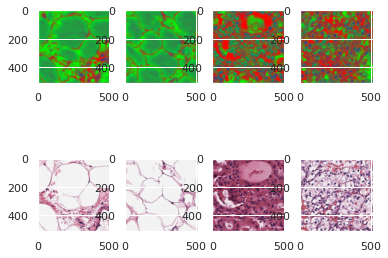

15 tensor(0.6760, device='cuda:0', grad_fn=<AddBackward0>)


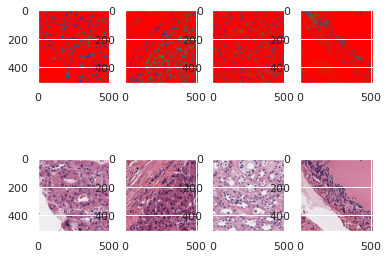

30 tensor(0.6098, device='cuda:0', grad_fn=<AddBackward0>)


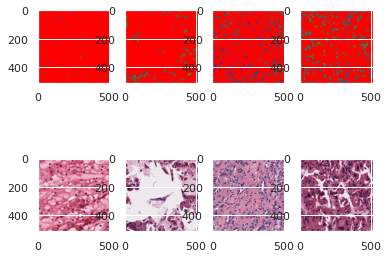

45 tensor(0.5862, device='cuda:0', grad_fn=<AddBackward0>)


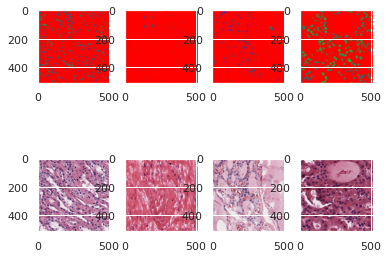

60 tensor(0.6971, device='cuda:0', grad_fn=<AddBackward0>)


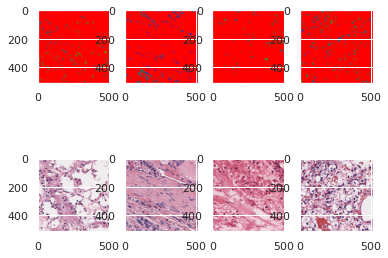

75 tensor(0.5123, device='cuda:0', grad_fn=<AddBackward0>)


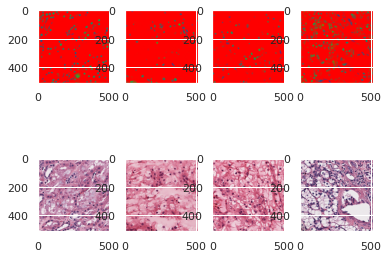

90 tensor(0.5881, device='cuda:0', grad_fn=<AddBackward0>)


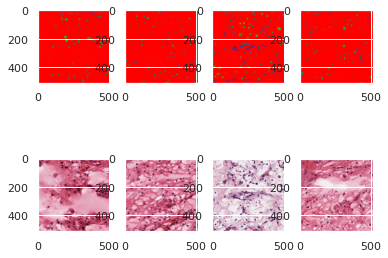

105 tensor(0.5393, device='cuda:0', grad_fn=<AddBackward0>)


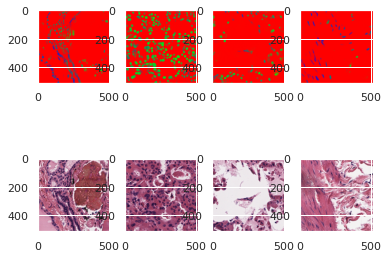

120 tensor(0.5953, device='cuda:0', grad_fn=<AddBackward0>)


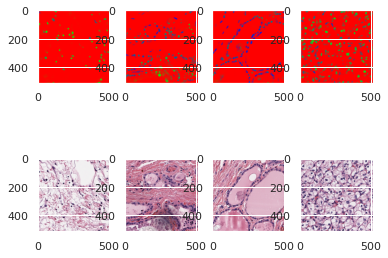

135 tensor(0.4945, device='cuda:0', grad_fn=<AddBackward0>)


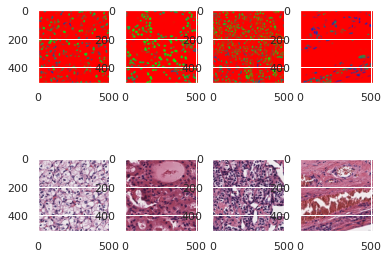

150 tensor(0.4773, device='cuda:0', grad_fn=<AddBackward0>)


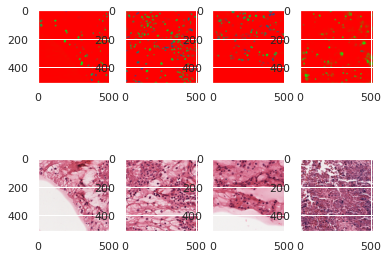

165 tensor(0.4599, device='cuda:0', grad_fn=<AddBackward0>)


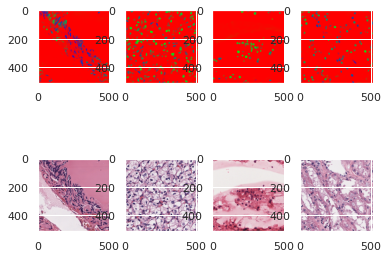

180 tensor(0.4641, device='cuda:0', grad_fn=<AddBackward0>)


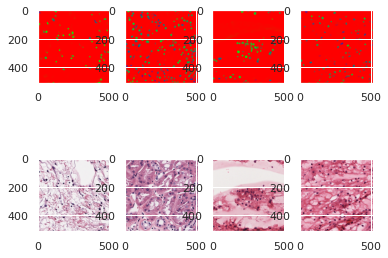

195 tensor(0.4899, device='cuda:0', grad_fn=<AddBackward0>)


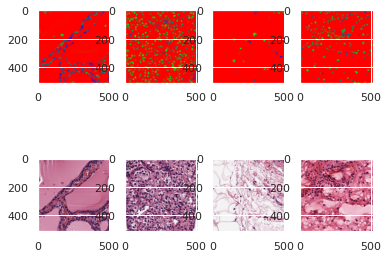

==== epoch 1 ====
0 tensor(0.4992, device='cuda:0', grad_fn=<AddBackward0>)


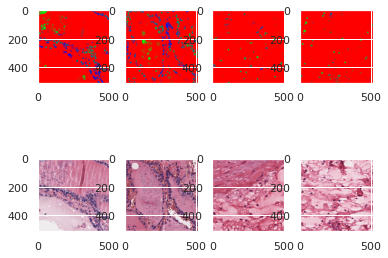

15 tensor(0.5197, device='cuda:0', grad_fn=<AddBackward0>)


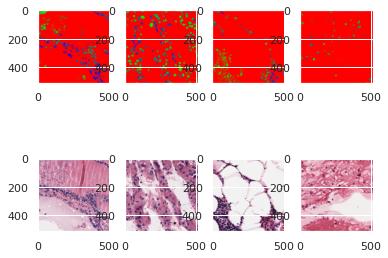

30 tensor(0.5284, device='cuda:0', grad_fn=<AddBackward0>)


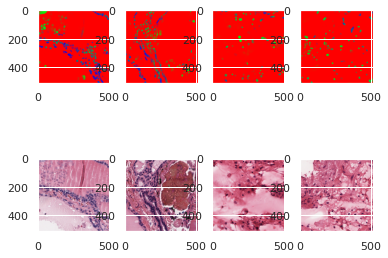

45 tensor(0.5056, device='cuda:0', grad_fn=<AddBackward0>)


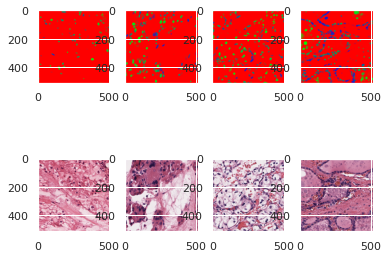

60 tensor(0.4743, device='cuda:0', grad_fn=<AddBackward0>)


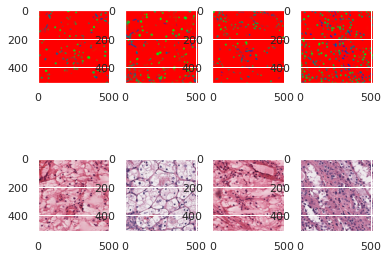

75 tensor(0.5767, device='cuda:0', grad_fn=<AddBackward0>)


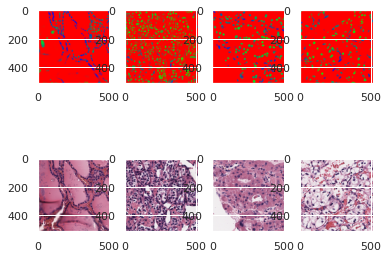

90 tensor(0.5340, device='cuda:0', grad_fn=<AddBackward0>)


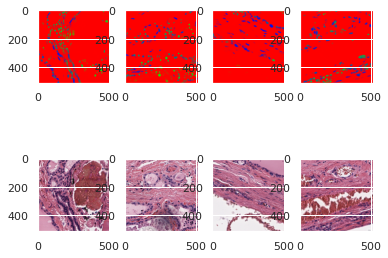

105 tensor(0.6319, device='cuda:0', grad_fn=<AddBackward0>)


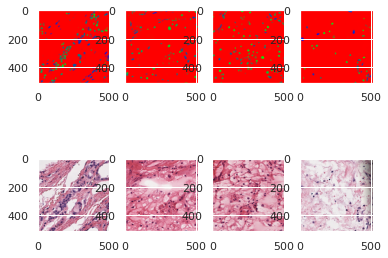

120 tensor(0.4261, device='cuda:0', grad_fn=<AddBackward0>)


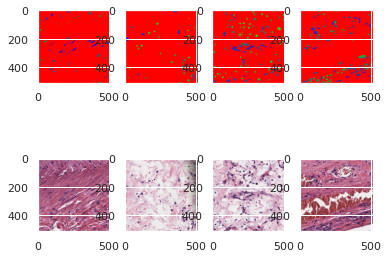

135 tensor(0.4854, device='cuda:0', grad_fn=<AddBackward0>)


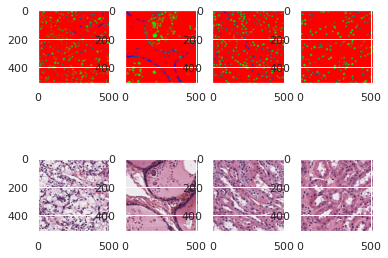

150 tensor(0.5374, device='cuda:0', grad_fn=<AddBackward0>)


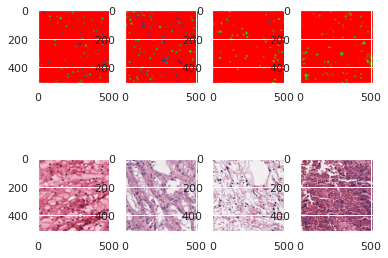

165 tensor(0.4259, device='cuda:0', grad_fn=<AddBackward0>)


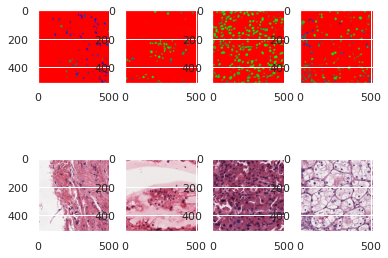

180 tensor(0.5253, device='cuda:0', grad_fn=<AddBackward0>)


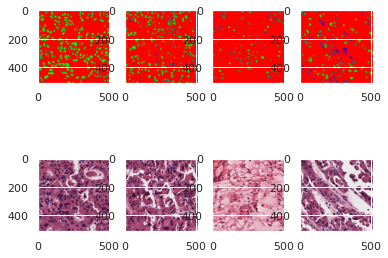

195 tensor(0.3989, device='cuda:0', grad_fn=<AddBackward0>)


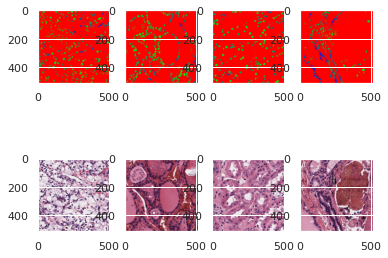

In [91]:
minibatch_train_losses = []
PLOT_FREQ = 15
NUM_VAL_VIS = 4
set_rc(6,5)
for epoch in range(2):
    print(f'==== epoch {epoch} ====')
    for batch_idx, (imgs, labels, ids) in enumerate(ft_dataloader):
        # match jacob's convention of using [0,255] floats (not what I normally do)
        imgs = imgs * 255
        
        # zero out gradient
        opt.zero_grad()

        ## use pretrained model to get initial outputs to work with
        with torch.no_grad():
            hovernet.eval()  # keeping frozen pretrained model components in eval mode 
            encoding = hovernet.encoder(imgs.cuda())
            frozen_outputs = hovernet(imgs.cuda()) # TODO modify forward pass to give encoding and outputs?
            if HEAD_ONLY:
                nc_branch_out = hovernet.nc_branch(encoding)  # decode 

        # get baseline nuclear segmentations
        preds_detection, preds_classification = post_process_batch_hovernet(frozen_outputs, n_classes=6)

        # generate pseudomasks
        pseudomasks = get_pseudomask(preds_detection, labels)
#         pseudomasks = get_pseudomask_noise(preds_detection, labels)
    
        if not HEAD_ONLY:
            # decode NC and transform with new fully tuned NC branch
            new_decoder.train()
            nc_branch_out = new_decoder(encoding)  # decode 
            
        ft_nc = decoder_post_fc(nc_branch_out) # transform

        # calc relevant losses and combine
        dice_loss_term = _dice_loss_nc_head(ft_nc, pseudomasks.cuda())
        crossent_loss_term = _ce_loss_nc_head(ft_nc, pseudomasks.cuda())
        loss = dice_loss_term + crossent_loss_term

        # track loss
        minibatch_train_losses.append(loss.item())

        # compute gradients
        loss.backward()

        # step optimizer and scheduler
        opt.step()

        if batch_idx % PLOT_FREQ == 0:
            print(batch_idx, loss)  
            for val_idx, (imgs, labels, ids) in enumerate(val_dataloader):
                # match jacob's convention of using [0,255] floats (not what I normally do)
                imgs = imgs * 255

                if val_idx == 0:
                    ## use pretrained model to get initial outputs to work with
                    with torch.no_grad():
                        encoding = hovernet.encoder(imgs.cuda())
                        if HEAD_ONLY:
                            nc_branch_out = hovernet.nc_branch(encoding)  # decode
                        if not HEAD_ONLY:
                            new_decoder.eval()
                            nc_branch_out = new_decoder(encoding)  # decode
                            
                        ft_nc = decoder_post_fc(nc_branch_out.cuda())

                    fig, axes = plt.subplots(2,NUM_VAL_VIS)
                    
                    for sub_idx in range(NUM_VAL_VIS):
                        axes[0, sub_idx].imshow(ft_nc[sub_idx].softmax(0).permute(1,2,0).detach().cpu().numpy())
                        axes[1, sub_idx].imshow(imgs[sub_idx].permute(1,2,0).long())
                    plt.show()

torch.save(decoder_post_fc.state_dict(), './20210224_decoder_post_fc_512px.pt') 

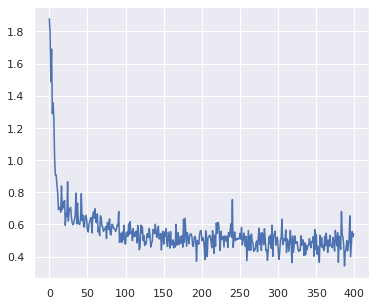

In [93]:
plt.plot(minibatch_train_losses)

In [95]:
RESUMING = False

In [97]:
# create new head layer to push NC to 3 classes 
if RESUMING:  # reload saved state dict if previously saved
    decoder_post_fc = nn.Conv2d(in_channels = 64, out_channels = 3, kernel_size = 1)
    decoder_post_fc.to('cuda');
    decoder_post_fc.load_state_dict(torch.load('./20210224_decoder_post_fc_512px.pt'))

    # load pretrained hovernet model
    checkpoint = torch.load("/mnt/disks/image_data/kidney/hover/hovernet_pannuke.pt", map_location='cpu')
    n_classes_pannuke = 6

    finetuned_hovernet = HoVerNet(n_classes=n_classes_pannuke)
    finetuned_hovernet = torch.nn.DataParallel(finetuned_hovernet)
    finetuned_hovernet.load_state_dict(checkpoint)
    finetuned_hovernet = finetuned_hovernet.module

    ## if using finetuned decoder, also load that in 
    # if not HEAD_ONLY:
    #     finetuned_hovernet.nc_branch.load_state_dict(new_decoder_ckpt)   # can just load state dict directly since it's the same module

# assign finetuned decoder NC head 
if not RESUMING:
    finetuned_hovernet = copy.deepcopy(hovernet)
finetuned_hovernet.nc_head[0] = decoder_post_fc  # need to manually assign new nn.Linear since different class dim in prediction logits

torch.save(finetuned_hovernet.state_dict(), './20210224_finetuned_hovernet_nc_tumorregion_vs_stromaregion_512px.pt')

In [119]:
finetuned_hovernet.nc_head

Sequential(
  (0): Conv2d(64, 3, kernel_size=(1, 1), stride=(1, 1))
)

In [ ]:
stop -- here is where we evaluate 

#### Use saved combination

In [11]:
loaded_hnt = HoVerNet(n_classes=3)
ft_ckpt = torch.load('./20210224_finetuned_hovernet_nc_tumorregion_vs_stromaregion_512px.pt')

In [12]:
loaded_hnt.load_state_dict(ft_ckpt)

<All keys matched successfully>

In [13]:
hovernet = loaded_hnt
hovernet.cuda();

In [14]:
eval_candidates =  pd.read_csv('./20210224_ccrcc_eval_candidates.csv').iloc[:,1].values

In [15]:
BATCH_SIZE = 6
CROP_SIZE = 512
WORKERS = 8

all_ids = paths.index.unique()
nonsubset_pred_tumor = paths.loc[[x for x in eval_candidates if x in all_ids]]
nonsubset_pred_tumor = nonsubset_pred_tumor.loc[nonsubset_pred_tumor.prob_tumor >= 0.7].sample(150)


pred_tumor_dataset = SlideDataset(
    paths=nonsubset_pred_tumor.full_path.values,
    slide_ids=nonsubset_pred_tumor.index.values,
    labels=nonsubset_pred_tumor.prob_tumor.values,
    transform_compose=RGBEvalTransform(512, CROP_SIZE, norm_mean=[0, 0, 0], norm_std=[1, 1, 1])
)

pred_tumor_dataloader = DataLoader(pred_tumor_dataset, batch_size=BATCH_SIZE, num_workers=WORKERS, shuffle=True)

0

=====:p(TvNT)=0.90


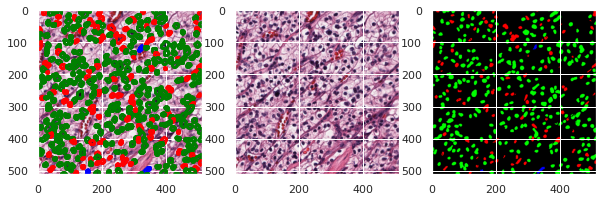


=====:p(TvNT)=0.98


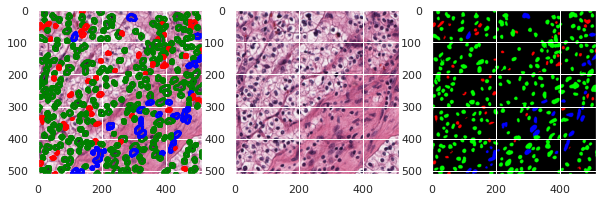


=====:p(TvNT)=0.92


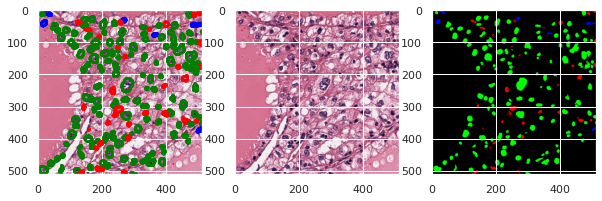


=====:p(TvNT)=0.98


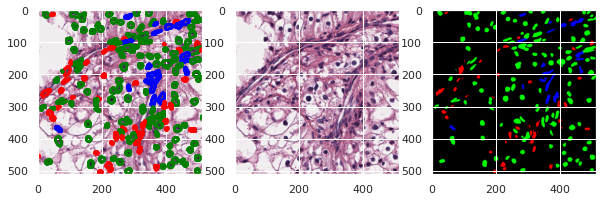


=====:p(TvNT)=0.88


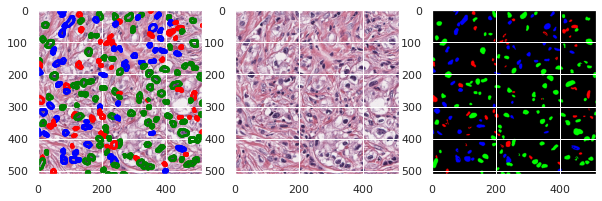

1

=====:p(TvNT)=0.99


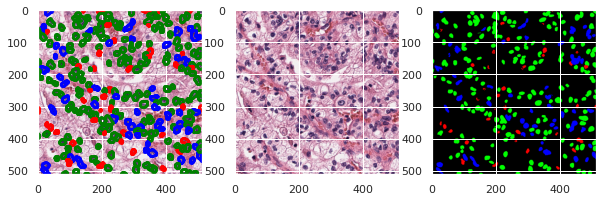


=====:p(TvNT)=0.99


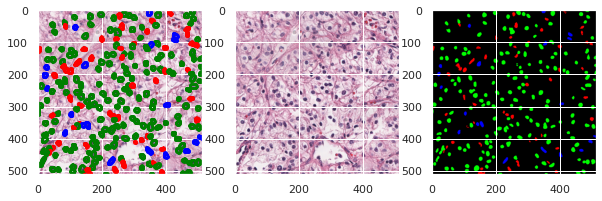


=====:p(TvNT)=0.99


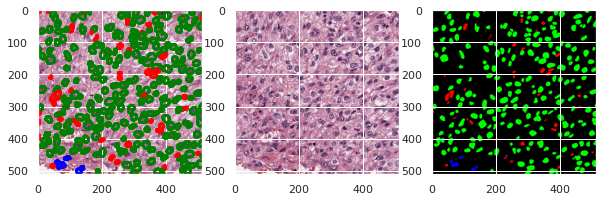


=====:p(TvNT)=0.99


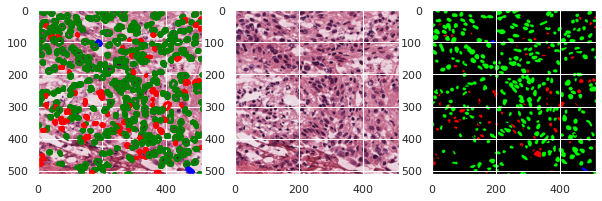


=====:p(TvNT)=0.98


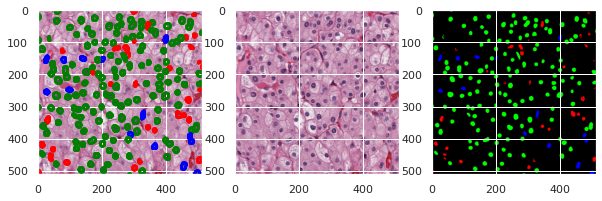

2

=====:p(TvNT)=0.98


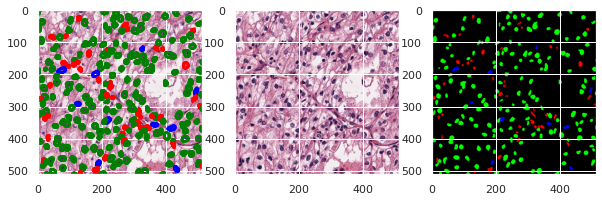


=====:p(TvNT)=0.94


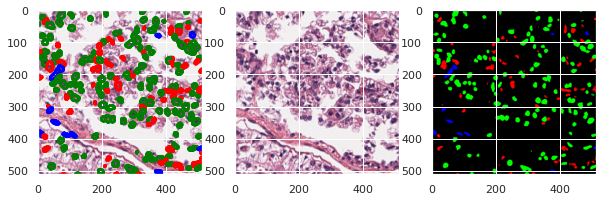


=====:p(TvNT)=0.77


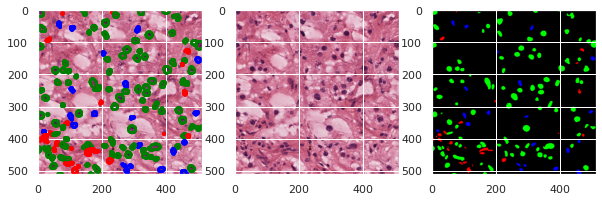


=====:p(TvNT)=0.96


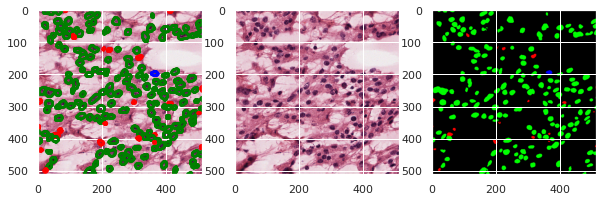


=====:p(TvNT)=0.95


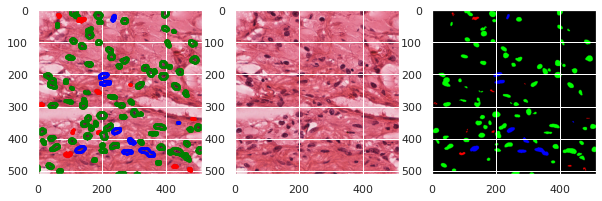

3

=====:p(TvNT)=0.99


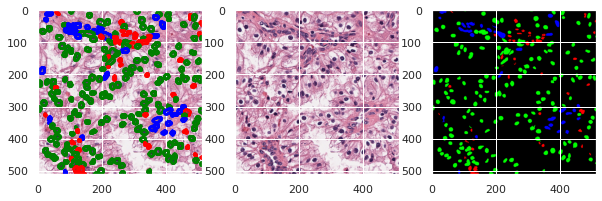


=====:p(TvNT)=0.95


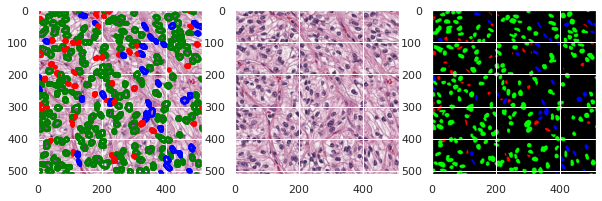


=====:p(TvNT)=0.92


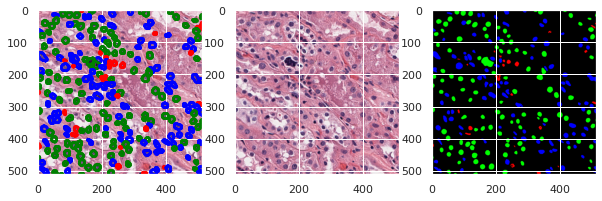


=====:p(TvNT)=0.93


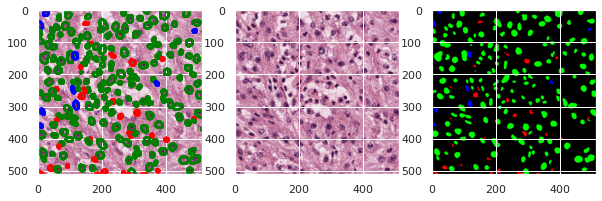


=====:p(TvNT)=0.98


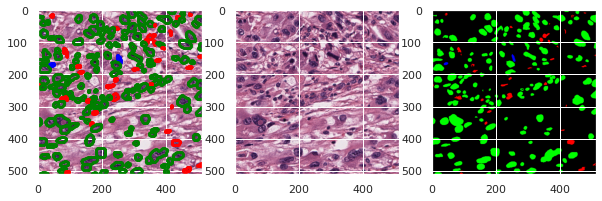

4

=====:p(TvNT)=0.91


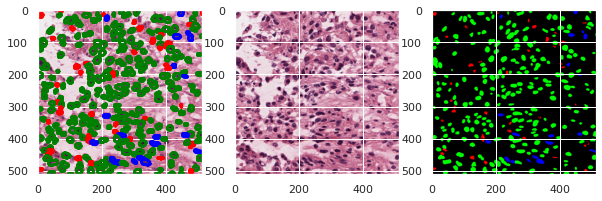


=====:p(TvNT)=0.98


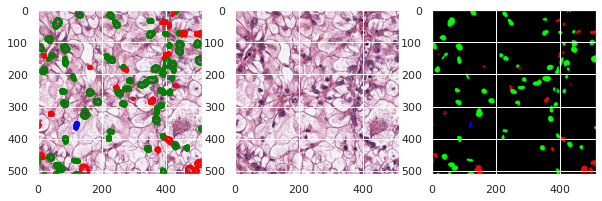


=====:p(TvNT)=0.88


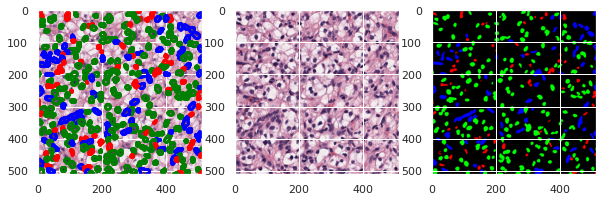


=====:p(TvNT)=0.98


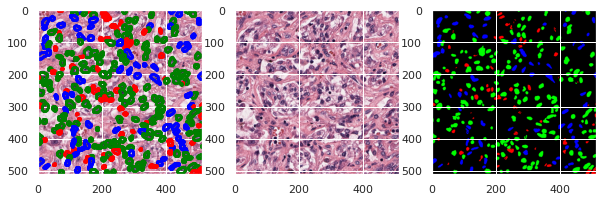


=====:p(TvNT)=0.99


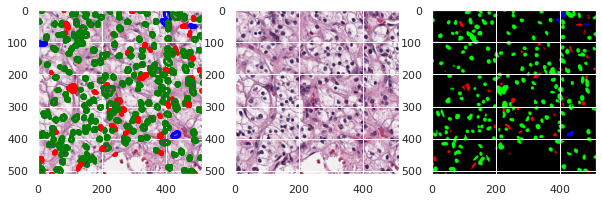

5

=====:p(TvNT)=0.87


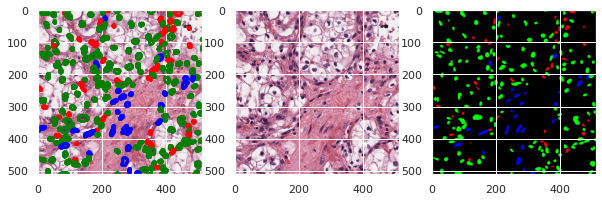


=====:p(TvNT)=0.95


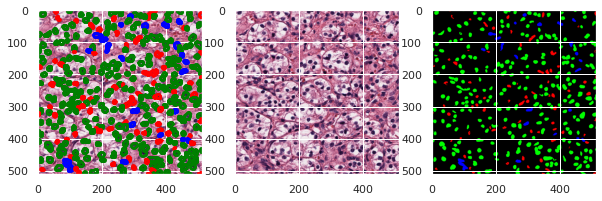


=====:p(TvNT)=0.77


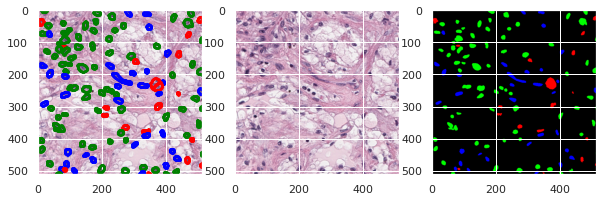


=====:p(TvNT)=0.94


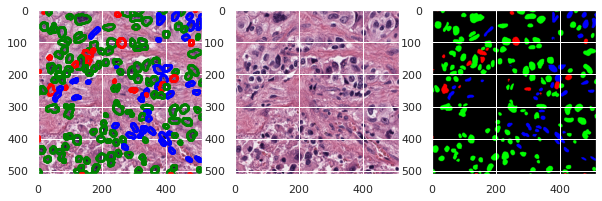


=====:p(TvNT)=0.76


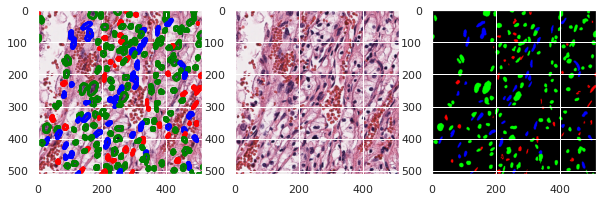

6

=====:p(TvNT)=1.00


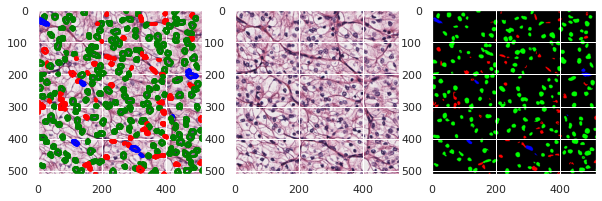


=====:p(TvNT)=0.94


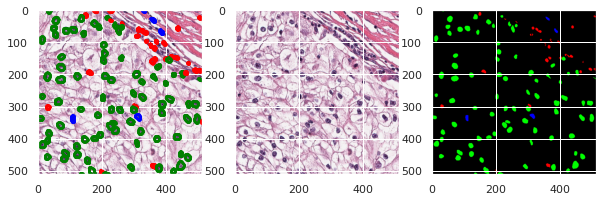


=====:p(TvNT)=1.00


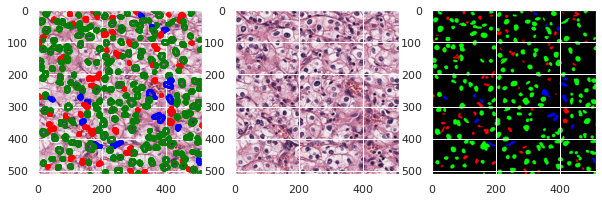


=====:p(TvNT)=0.81


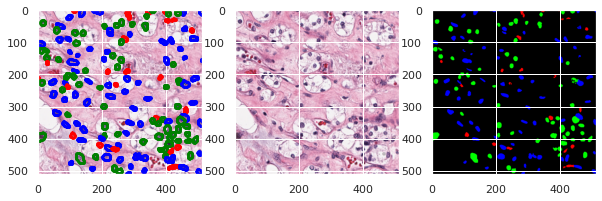


=====:p(TvNT)=0.90


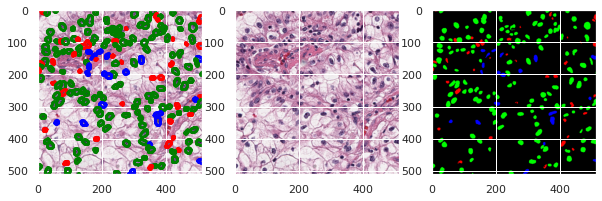

7

=====:p(TvNT)=0.90


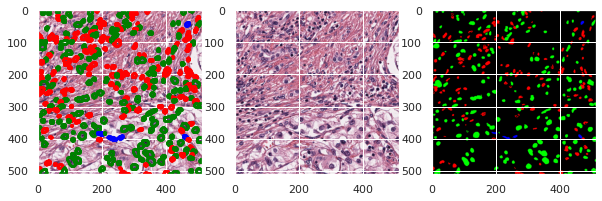


=====:p(TvNT)=0.96


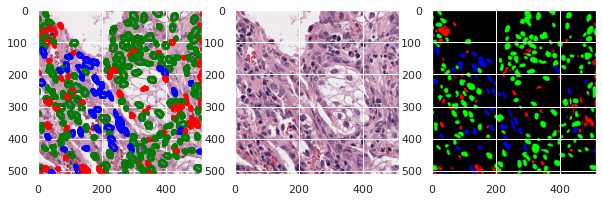


=====:p(TvNT)=0.99


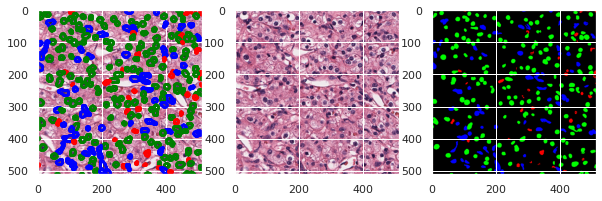


=====:p(TvNT)=0.82


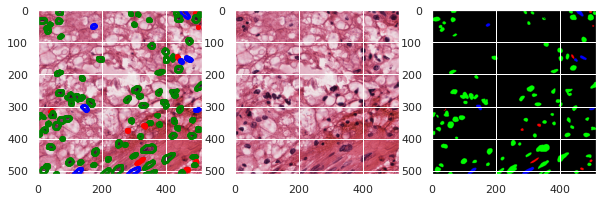


=====:p(TvNT)=0.94


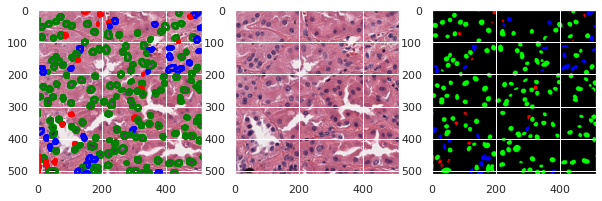

8

=====:p(TvNT)=0.76


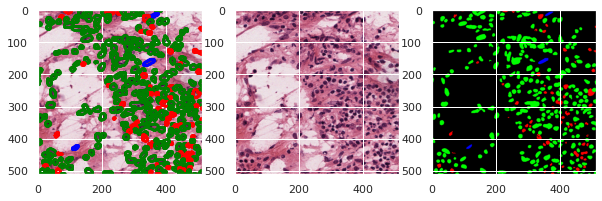


=====:p(TvNT)=0.92


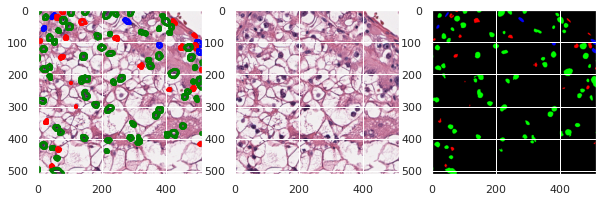


=====:p(TvNT)=0.99


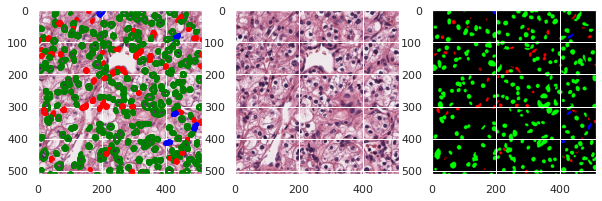


=====:p(TvNT)=0.90


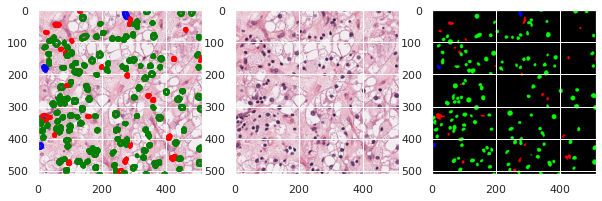


=====:p(TvNT)=0.95


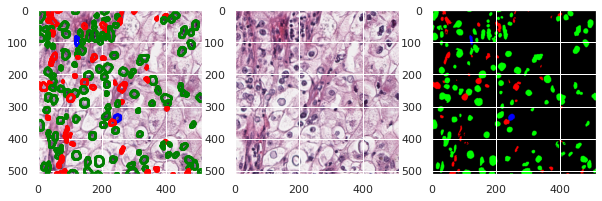

9

=====:p(TvNT)=0.99


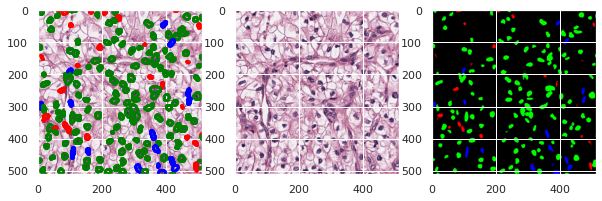


=====:p(TvNT)=0.92


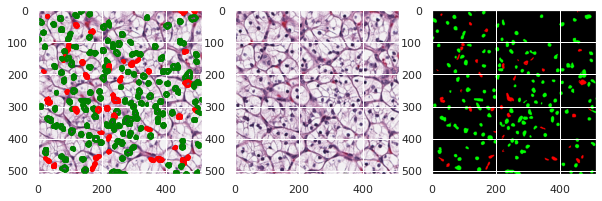


=====:p(TvNT)=0.97


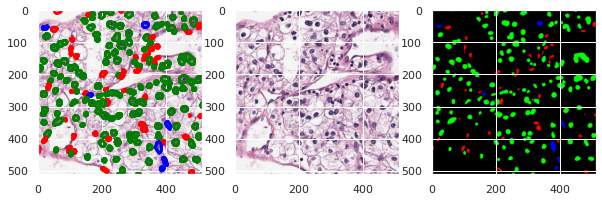


=====:p(TvNT)=0.80


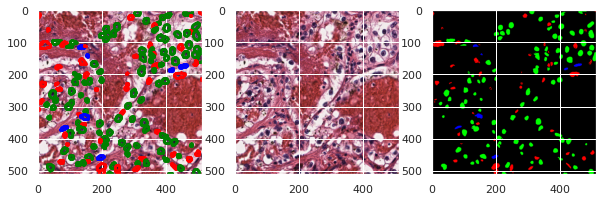


=====:p(TvNT)=0.95


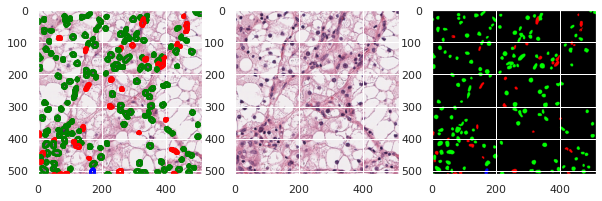

10

=====:p(TvNT)=0.81


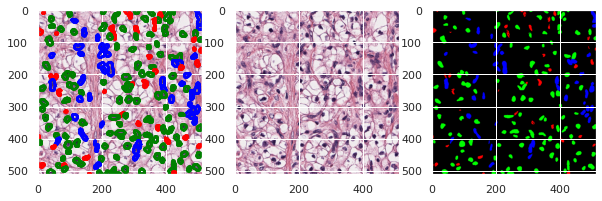


=====:p(TvNT)=0.88


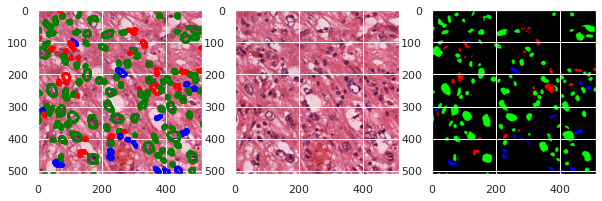


=====:p(TvNT)=0.99


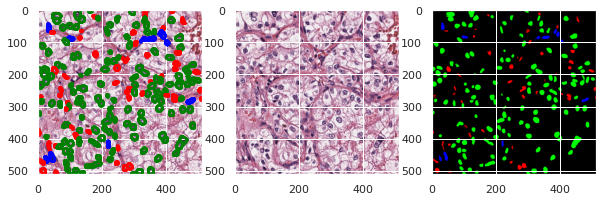


=====:p(TvNT)=0.95


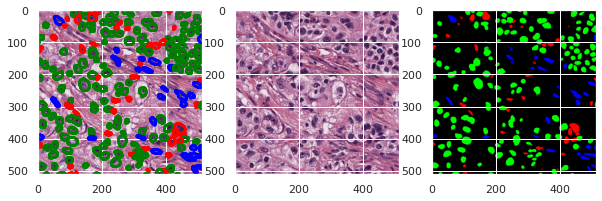


=====:p(TvNT)=0.92


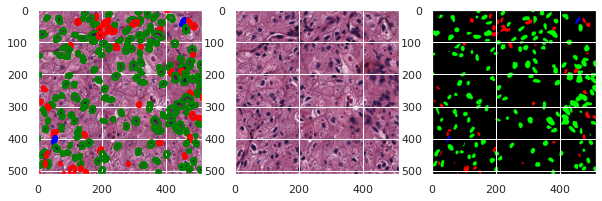

11

=====:p(TvNT)=0.93


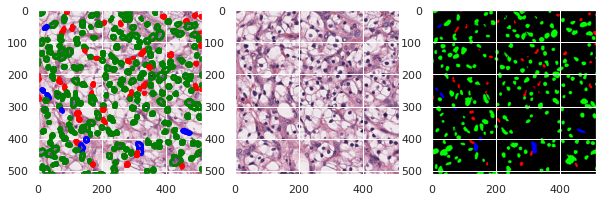


=====:p(TvNT)=0.91


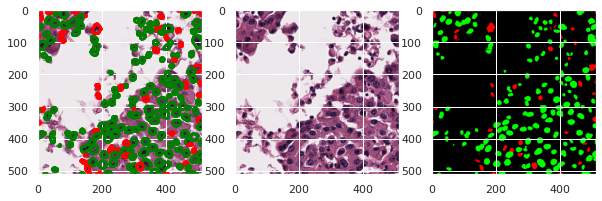


=====:p(TvNT)=0.99


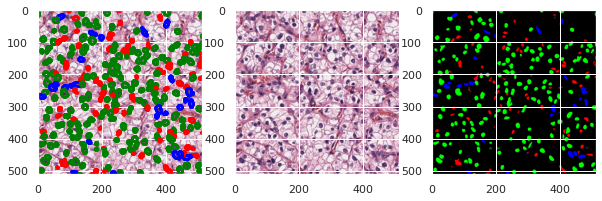


=====:p(TvNT)=0.71


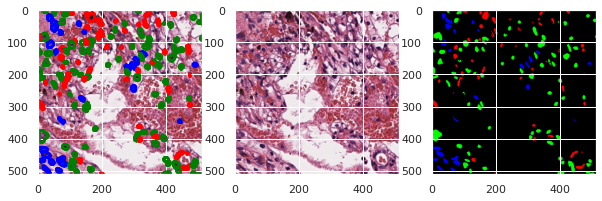


=====:p(TvNT)=0.97


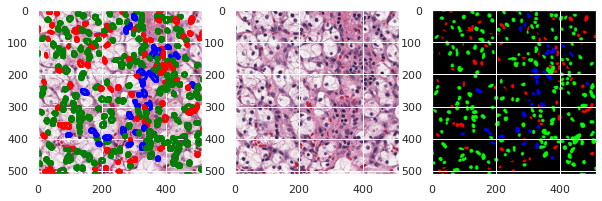

12

=====:p(TvNT)=0.91


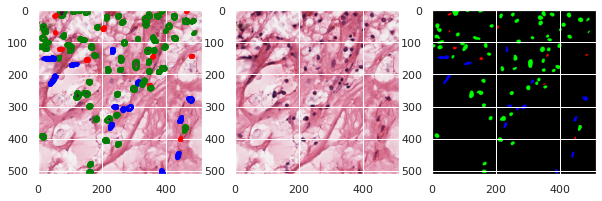


=====:p(TvNT)=0.86


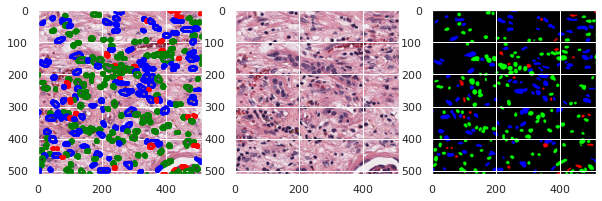


=====:p(TvNT)=0.97


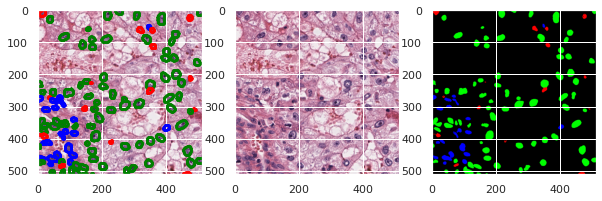


=====:p(TvNT)=0.98


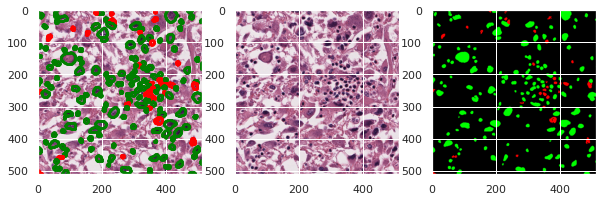


=====:p(TvNT)=0.98


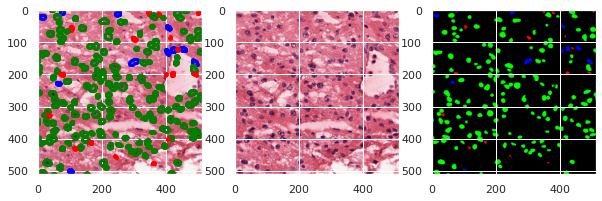

13

=====:p(TvNT)=0.98


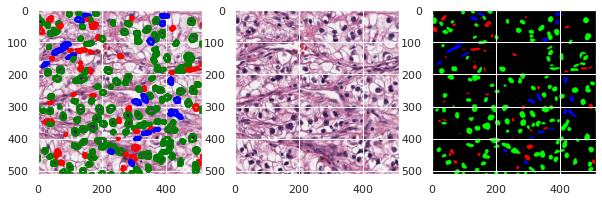


=====:p(TvNT)=0.97


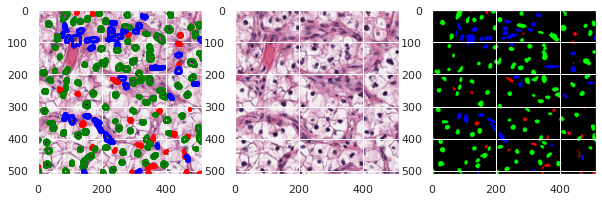


=====:p(TvNT)=0.96


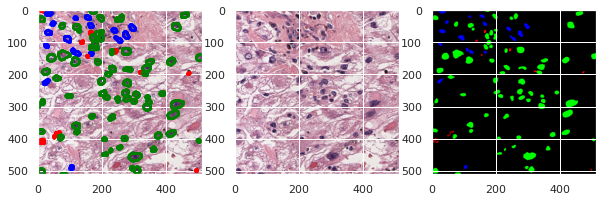


=====:p(TvNT)=0.88


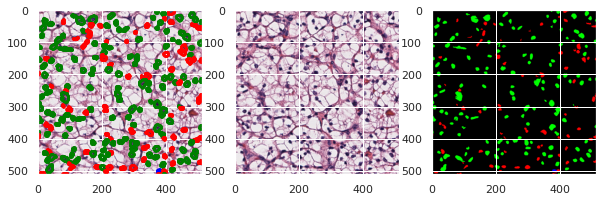


=====:p(TvNT)=0.96


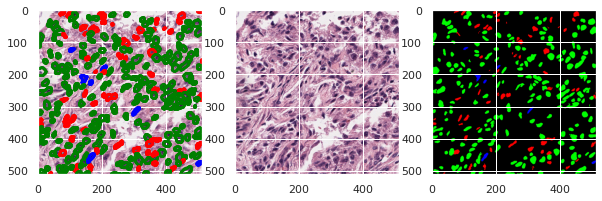

14

=====:p(TvNT)=1.00


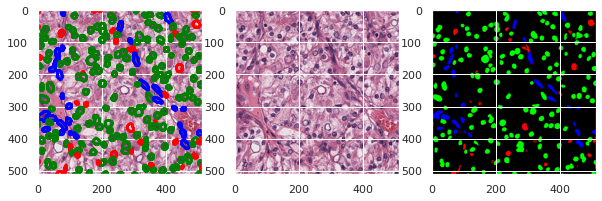


=====:p(TvNT)=0.99


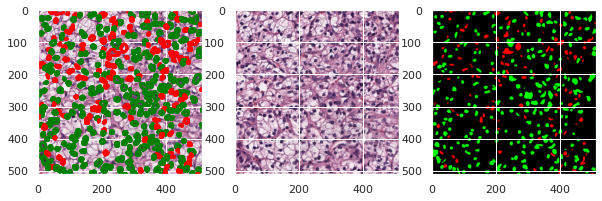


=====:p(TvNT)=0.75


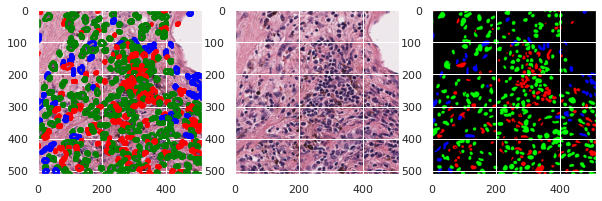


=====:p(TvNT)=1.00


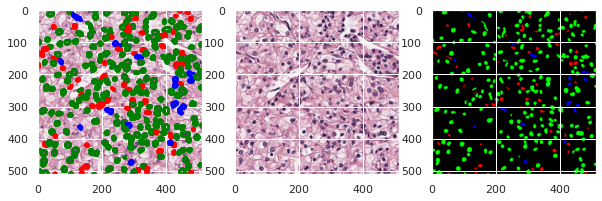


=====:p(TvNT)=0.96


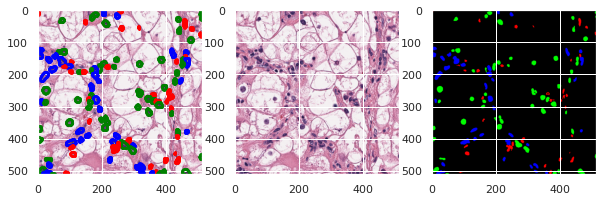

15

=====:p(TvNT)=0.98


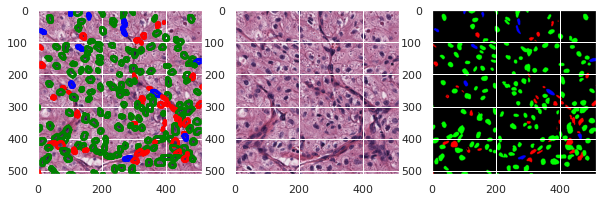


=====:p(TvNT)=0.85


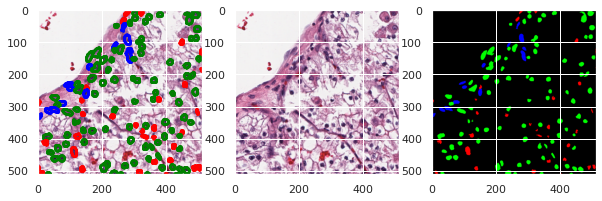


=====:p(TvNT)=0.79


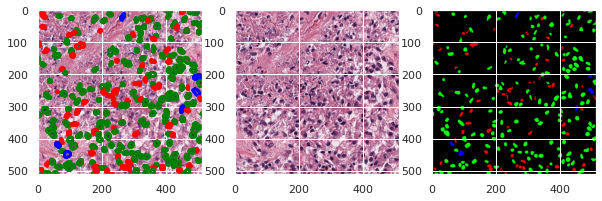


=====:p(TvNT)=0.94


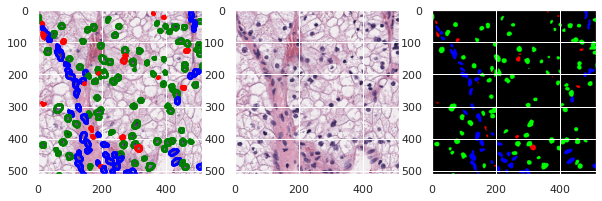


=====:p(TvNT)=0.99


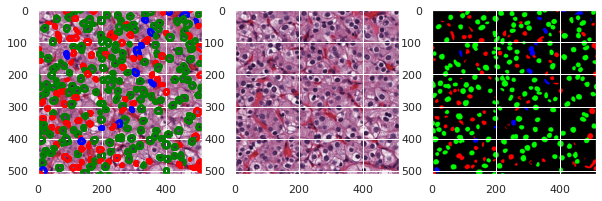

16

=====:p(TvNT)=0.99


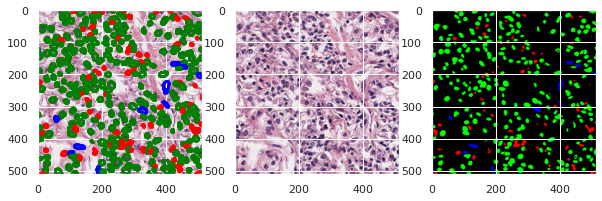


=====:p(TvNT)=0.99


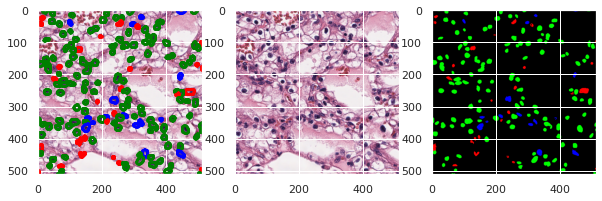


=====:p(TvNT)=0.97


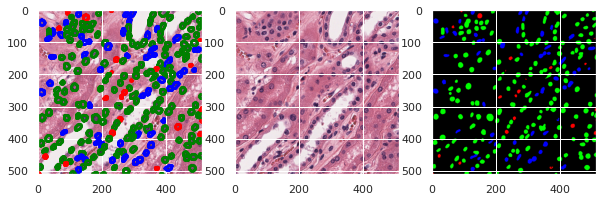


=====:p(TvNT)=0.96


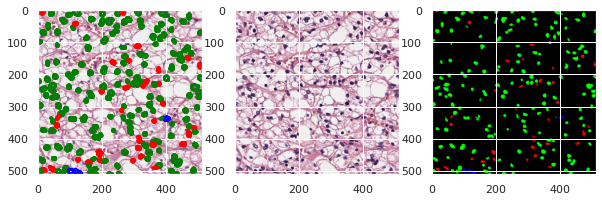


=====:p(TvNT)=0.95


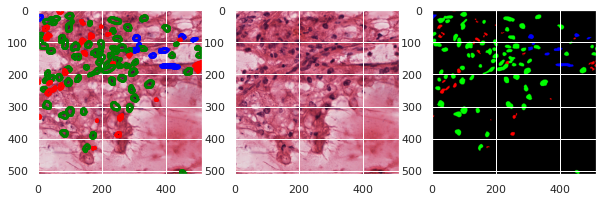

17

=====:p(TvNT)=0.99


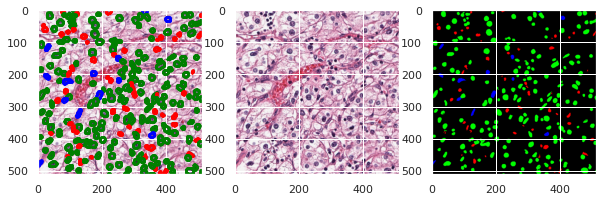


=====:p(TvNT)=0.94


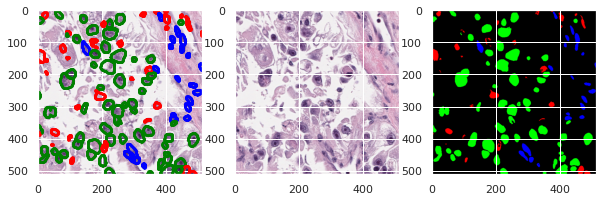


=====:p(TvNT)=0.99


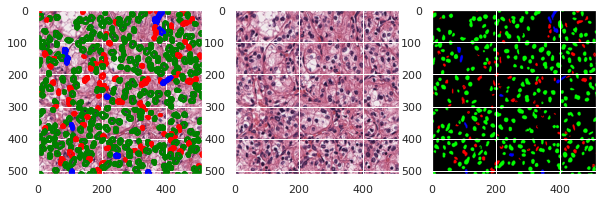


=====:p(TvNT)=0.88


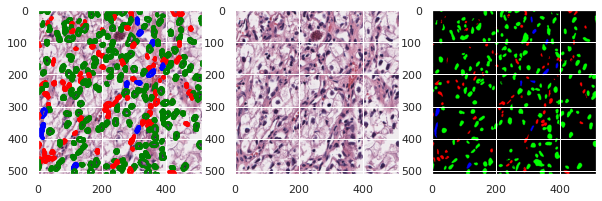


=====:p(TvNT)=0.99


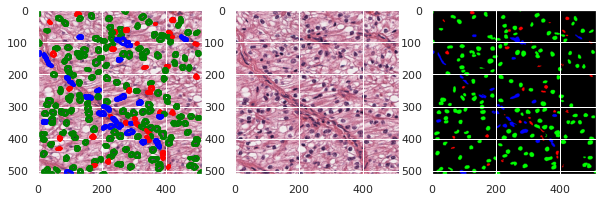

18

=====:p(TvNT)=0.93


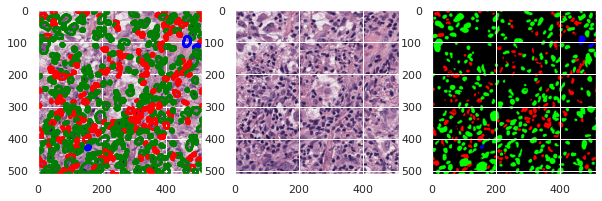


=====:p(TvNT)=0.77


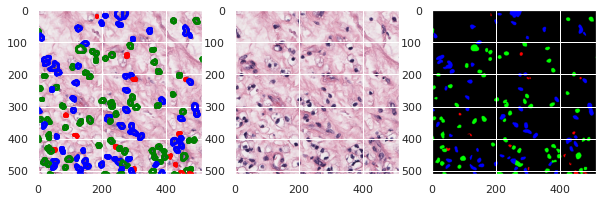


=====:p(TvNT)=0.84


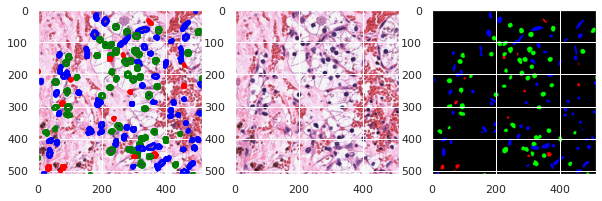


=====:p(TvNT)=0.97


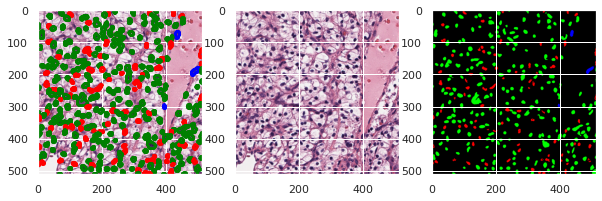


=====:p(TvNT)=0.97


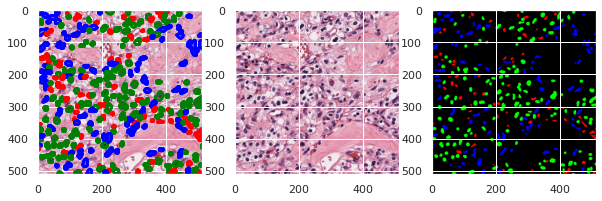

19

=====:p(TvNT)=0.98


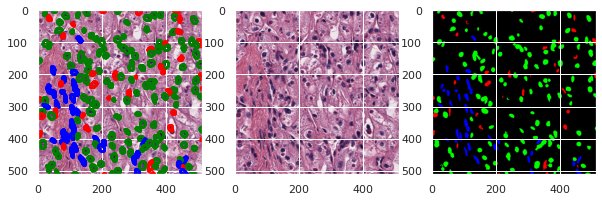


=====:p(TvNT)=0.93


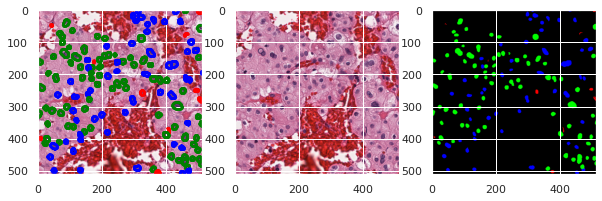


=====:p(TvNT)=0.94


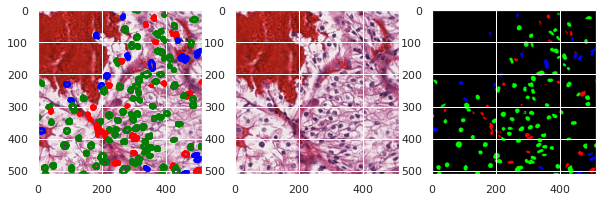


=====:p(TvNT)=0.85


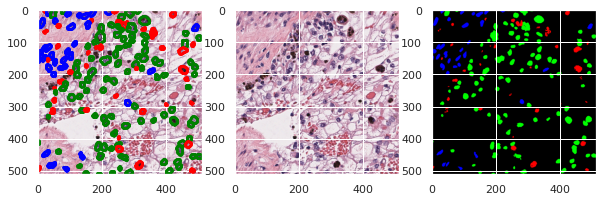


=====:p(TvNT)=0.97


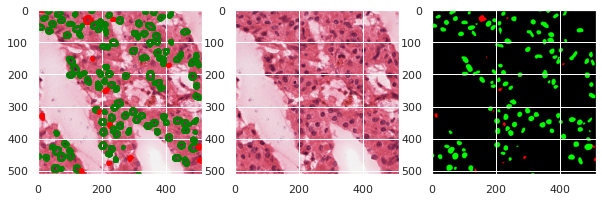

20

=====:p(TvNT)=0.99


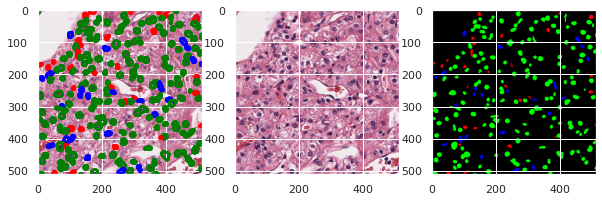


=====:p(TvNT)=0.72


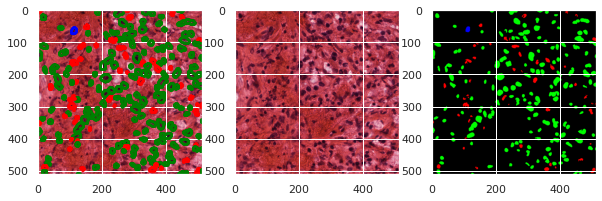


=====:p(TvNT)=1.00


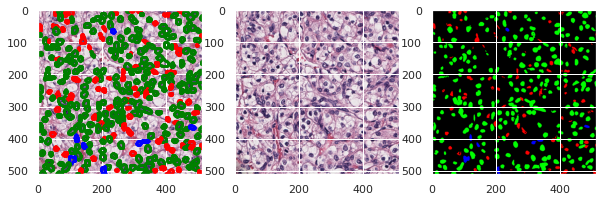


=====:p(TvNT)=0.98


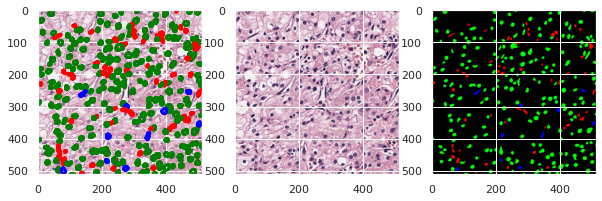


=====:p(TvNT)=0.83


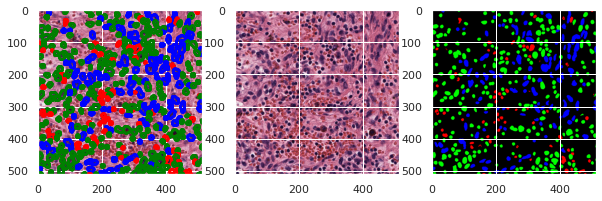

21

=====:p(TvNT)=0.93


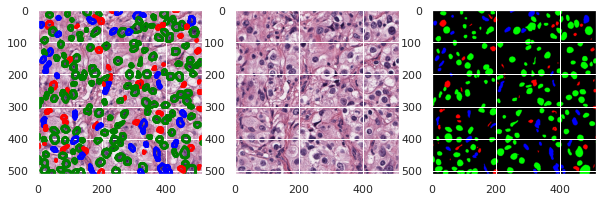


=====:p(TvNT)=0.99


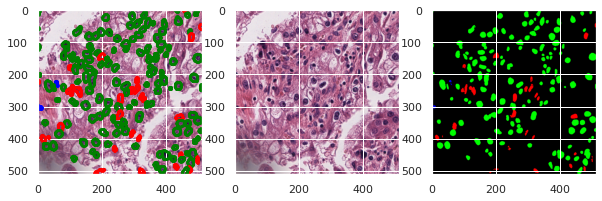


=====:p(TvNT)=0.98


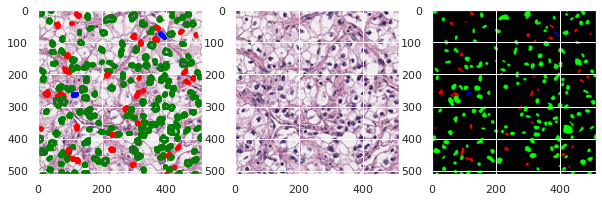


=====:p(TvNT)=0.99


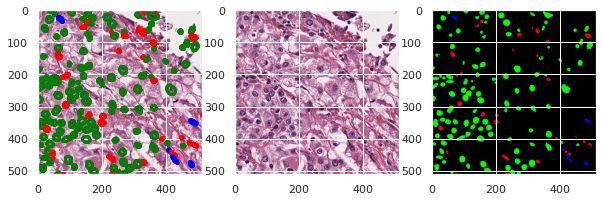


=====:p(TvNT)=0.99


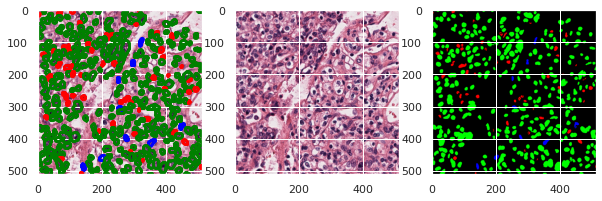

22

=====:p(TvNT)=0.83


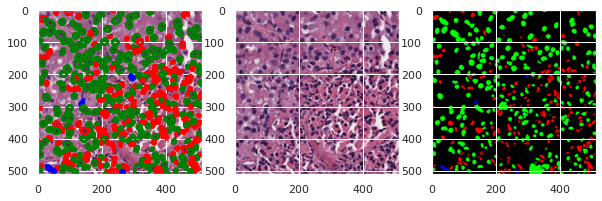


=====:p(TvNT)=0.98


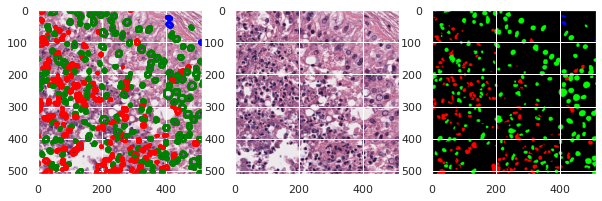


=====:p(TvNT)=0.97


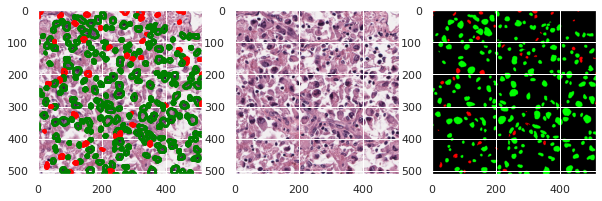


=====:p(TvNT)=0.99


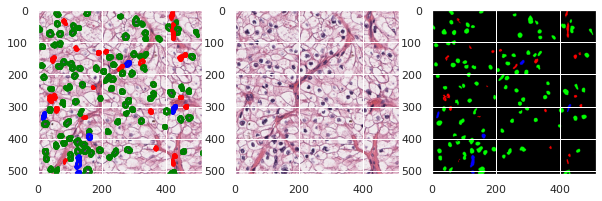


=====:p(TvNT)=0.99


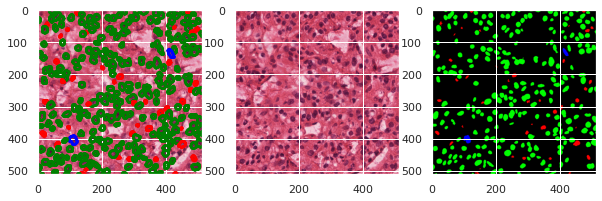

23

=====:p(TvNT)=0.98


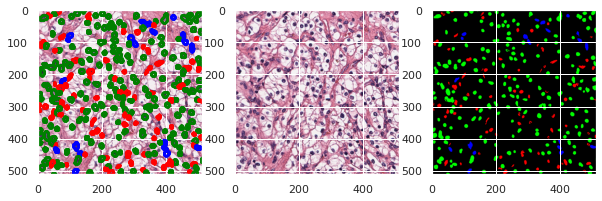


=====:p(TvNT)=0.97


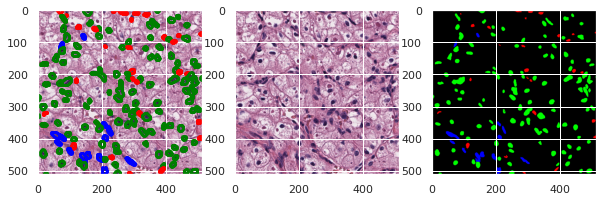


=====:p(TvNT)=0.94


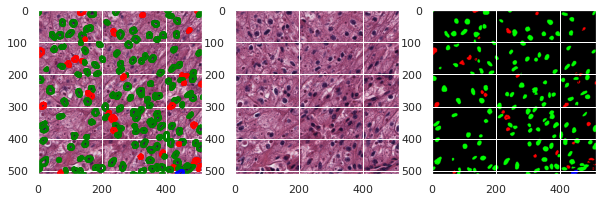


=====:p(TvNT)=0.99


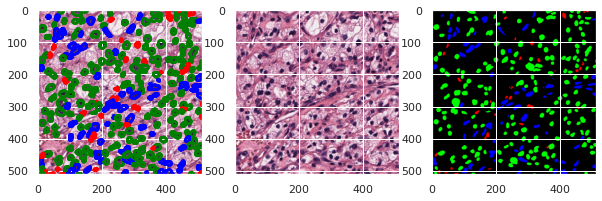


=====:p(TvNT)=0.86


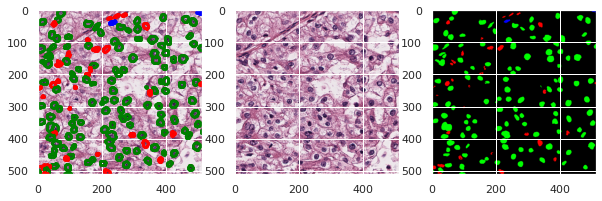

24

=====:p(TvNT)=0.93


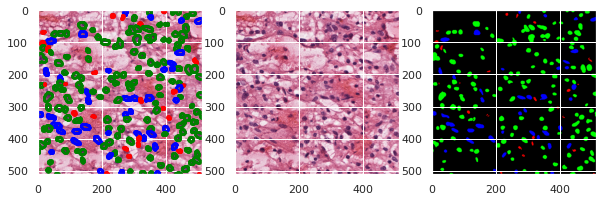


=====:p(TvNT)=0.77


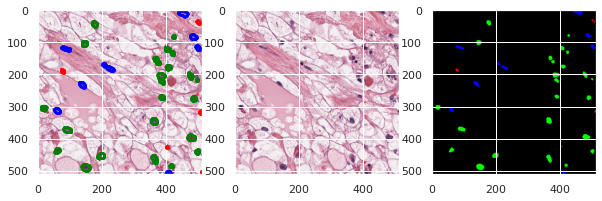


=====:p(TvNT)=1.00


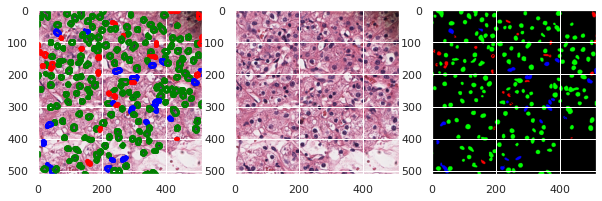


=====:p(TvNT)=0.98


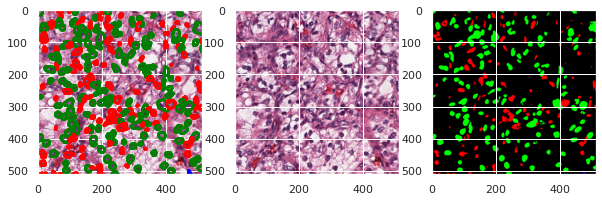


=====:p(TvNT)=0.73


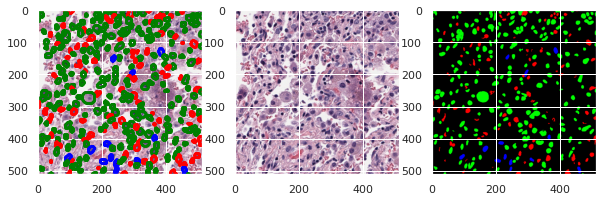

In [16]:
set_rc(10,5)
preds_detection_store = []
ft_preds_classification_store = []
labels_store = []
ids_store = []
img_store = []


hovernet.eval()
for batch_idx, (imgs, labels, ids) in enumerate(pred_tumor_dataloader):
    print(batch_idx)
    # match jacob's convention of using [0,255] floats (not what I normally do)
    imgs = imgs * 255
    ## use pretrained model to get initial outputs to work with
    with torch.no_grad():
        encoding = hovernet.encoder(imgs.cuda())
        frozen_outputs = hovernet(imgs.cuda())
        
    preds_detection, ft_preds_classification = post_process_batch_hovernet(frozen_outputs, n_classes=3)
    ft_preds_classification_store.append(ft_preds_classification)
    preds_detection_store.append(preds_detection)
    labels_store.append(labels)
    ids_store.append(ids)
    img_store.append(imgs.cpu())
        
    for idx in range(5):
    # for idx in range(len(imgs)):
        print(f'\n=====:p(TvNT)={labels[idx]:.2f}')
        fig, axes = plt.subplots(1,3)
        plot_segmentation(ax=axes[0], masks=ft_preds_classification[idx], palette=rgb_pal)
        axes[0].imshow(imgs[idx].permute(1,2,0).long())
        axes[1].imshow(imgs[idx].permute(1,2,0).long())
        axes[2].imshow((ft_preds_classification[idx].transpose((1,2,0)) > 0).astype(float))
        plt.show()


In [20]:
preds_detection_store = np.concatenate(preds_detection_store)
ft_preds_classification_store = np.concatenate(ft_preds_classification_store)
labels_store = np.concatenate(labels_store)
ids_store = np.concatenate(ids_store)
img_store = np.concatenate(img_store)

In [21]:
store_agg = {
    'preds_detection_store': preds_detection_store,
    'ft_preds_classification_store': ft_preds_classification_store,
    'labels_store': labels_store,
    'ids_store': ids_store,
    'img_store': img_store,
#     'train_paths':subset,
#     'val_high_ptvnt_subset':nonsubset_pred_tumor,
}

torch.save(store_agg, '20210224_ptvnt_geq070_seg_class_preds_finetuned_head_only_512px_input_heldout_randomsubset150.pth')

### Run a few full slides

In [15]:
eval_candidates_sub = [x for x in eval_candidates if x in paths.index.values]
eval_samples = pd.Series(eval_candidates_sub).sample(5)

In [16]:
paths = get_merged_df(paths, anno[['UNIQUE_SAMPLE_ID']])
paths = paths.rename(columns={'UNIQUE_SAMPLE_ID':'unique_id'})

In [17]:
def get_dataloader(paths, batch_size=5, num_workers=8, shuffle=False, crop_size=512):
    dataset = SlideDataset(
        paths=paths.full_path.values,
        slide_ids=paths.index.values,
        labels=paths[['x','y']].values,
        transform_compose=RGBEvalTransform(512, crop_size, norm_mean=[0, 0, 0], norm_std=[1, 1, 1])
    )
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=num_workers, shuffle=shuffle, pin_memory=True)
    
    return dataloader

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


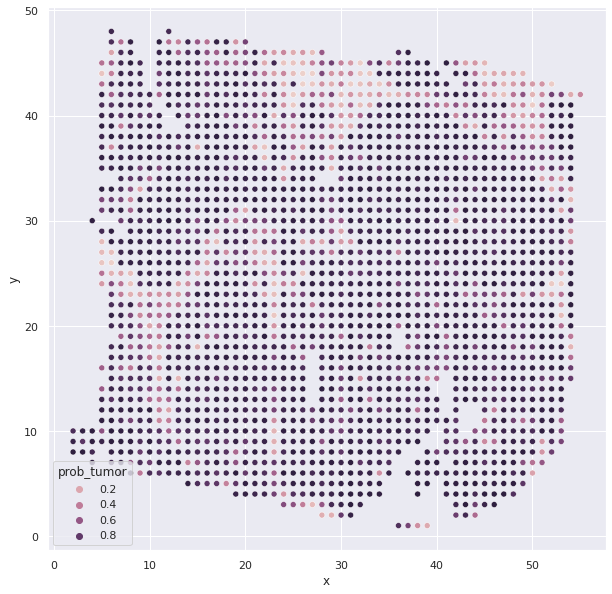

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


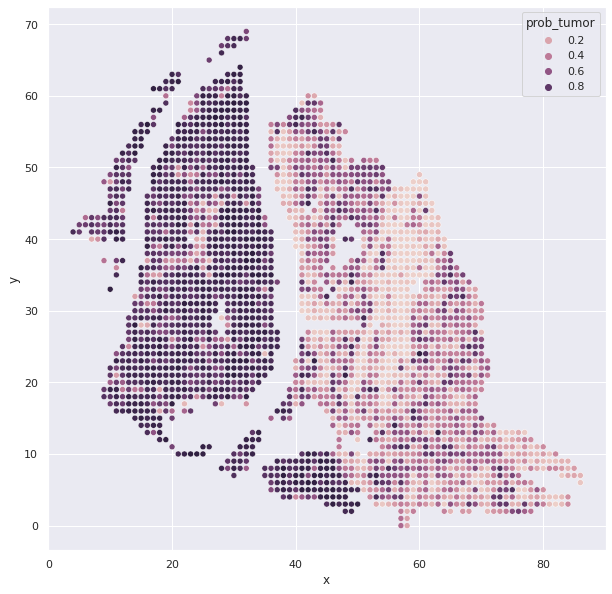

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


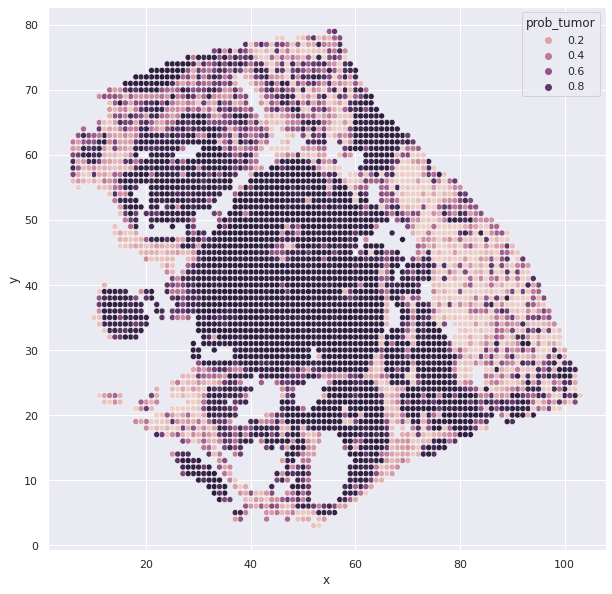

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


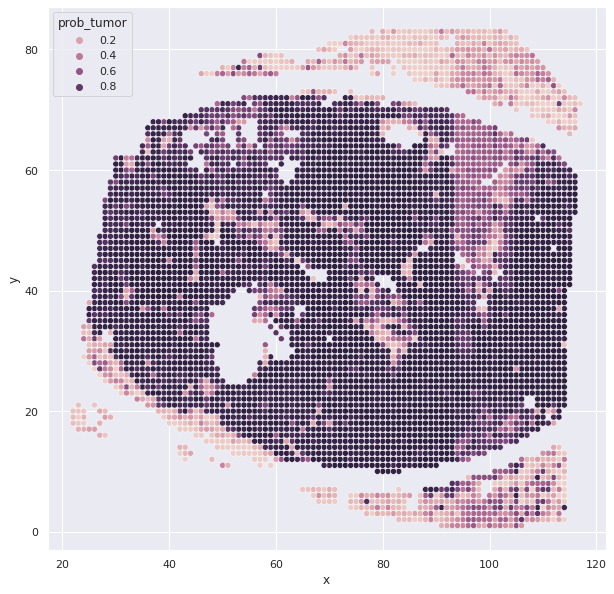

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


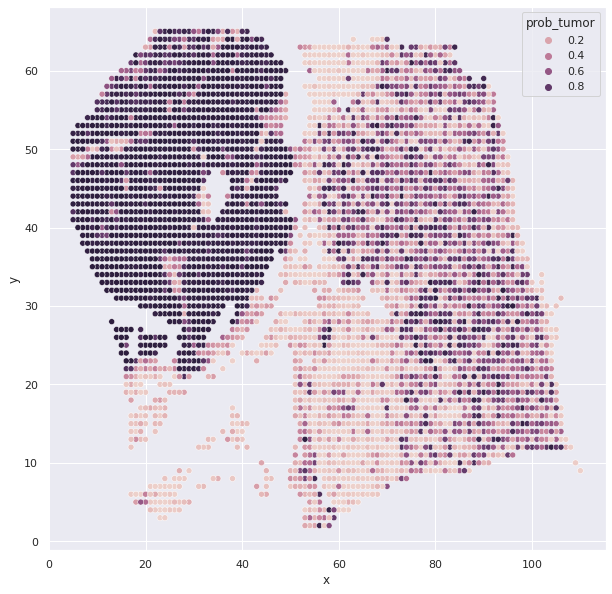

In [18]:
set_rc(10,10)
for sample in eval_samples:
    sns.scatterplot('x','y', data=paths.loc[sample], hue='prob_tumor')
    plt.show()

In [19]:
eval_paths = paths.loc[eval_samples.values]

In [20]:
eval_paths = eval_paths.reset_index(drop=False).set_index('unique_id')

In [41]:
eval_paths.index.unique()

Int64Index([1082196, 1079271, 1081576, 1092922, 1085914], dtype='int64', name='unique_id')

In [42]:
info_store = {}
for unique_id in eval_paths.index.unique():
    print(unique_id)
    dataloader = get_dataloader(eval_paths.loc[unique_id], batch_size=8)
    temp_info = process_slide(dataloader, hovernet)
    info_store[unique_id] = temp_info

1082196
1079271
Issue with batch 0, file 0
Issue with batch 0, file 4
Issue with batch 3, file 5
Issue with batch 4, file 4
Issue with batch 5, file 6
Issue with batch 6, file 1
Issue with batch 6, file 7
Issue with batch 7, file 7
Issue with batch 8, file 3
Issue with batch 9, file 1
Issue with batch 9, file 7
Issue with batch 11, file 3
Issue with batch 11, file 7
Issue with batch 12, file 0
Issue with batch 12, file 6
Issue with batch 12, file 7
Issue with batch 13, file 6
Issue with batch 14, file 0
Issue with batch 14, file 5
Issue with batch 16, file 0
Issue with batch 16, file 2
Issue with batch 17, file 2
Issue with batch 18, file 3
Issue with batch 19, file 5
Issue with batch 20, file 1
Issue with batch 24, file 1
Issue with batch 24, file 3
Issue with batch 24, file 5
Issue with batch 25, file 2
Issue with batch 25, file 6
Issue with batch 26, file 5
Issue with batch 27, file 4
Issue with batch 27, file 5
Issue with batch 28, file 7
Issue with batch 29, file 0
Issue with batc

- Probably smarter to break down `process_slide` to first run through a segmentation + saving step, THEN post-processing?
    - Regardless, should save the output masks. Probably as a .pt object? (Dont want to assume # channels / RGB coherence)

In [43]:
len(info_store)

5

In [45]:
torch.save(info_store, './20210224_eval_examples_hovernet_finetuned.pt')

In [47]:
info_store[1082196]

,cx,cy,eccentricity,area,roundness,solidity,intensity,file_id,prob_tumor,nc_bin,nc_category,contour_idx,tissue_class,tx,ty
0,138.0,502.0,0.714099,30.0,1.303738,0.833333,86.015808,1082196,XXXXX,0,background,0,tumor,43,44
1,315.0,492.0,0.832926,122.0,1.263086,0.910448,75.176224,1082196,XXXXX,0,background,1,tumor,43,44
2,332.0,479.0,0.859825,173.0,1.199784,0.922667,64.443817,1082196,XXXXX,0,background,2,tumor,43,44
3,328.0,468.0,0.765985,59.5,1.184343,0.901515,75.123238,1082196,XXXXX,0,background,3,tumor,43,44
4,347.0,466.0,0.727984,66.5,1.062961,0.985185,70.978783,1082196,XXXXX,0,background,4,til,43,44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,29.0,71.0,0.707107,4.0,1.079979,1.000000,171.468246,1082196,XXXXX,2,stroma,142,stroma,50,26
143,45.0,51.0,0.893298,242.0,1.247049,0.928983,118.043732,1082196,XXXXX,2,stroma,143,stroma,50,26
144,58.0,37.0,0.907676,178.5,1.200769,0.962264,80.866165,1082196,XXXXX,2,stroma,144,stroma,50,26
145,228.0,28.0,0.696172,561.0,1.703778,0.790141,101.392075,1082196,XXXXX,2,stroma,145,stroma,50,26


In [48]:
all_dfs = pd.concat(list(info_store.values()))

In [49]:
all_dfs.shape

(3757599, 15)

In [51]:
all_dfs.to_pickle('./20210224_eval_examples_hovernet_finetuned_agg_df.pkl')

In [53]:
def add_ws_coords(df_agg):
    df_agg['ws_x'] = (df_agg['tx']*512) + df_agg['cx']
    df_agg['ws_y'] = (df_agg['ty']*512) + df_agg['cy']

In [56]:
x = copy.deepcopy(info_store[1082196].head())

In [57]:
add_ws_coords(x)

In [58]:
x

,cx,cy,eccentricity,area,roundness,solidity,intensity,file_id,prob_tumor,nc_bin,nc_category,contour_idx,tissue_class,tx,ty,ws_x,ws_y
0,138.0,502.0,0.714099,30.0,1.303738,0.833333,86.015808,1082196,XXXXX,0,background,0,tumor,43,44,22154.0,23030.0
1,315.0,492.0,0.832926,122.0,1.263086,0.910448,75.176224,1082196,XXXXX,0,background,1,tumor,43,44,22331.0,23020.0
2,332.0,479.0,0.859825,173.0,1.199784,0.922667,64.443817,1082196,XXXXX,0,background,2,tumor,43,44,22348.0,23007.0
3,328.0,468.0,0.765985,59.5,1.184343,0.901515,75.123238,1082196,XXXXX,0,background,3,tumor,43,44,22344.0,22996.0
4,347.0,466.0,0.727984,66.5,1.062961,0.985185,70.978783,1082196,XXXXX,0,background,4,til,43,44,22363.0,22994.0


In [59]:
add_ws_coords(all_dfs)

In [65]:
all_dfs = all_dfs.set_index('file_id')

In [63]:
info_store.keys()

dict_keys([1082196, 1079271, 1081576, 1092922, 1085914])

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


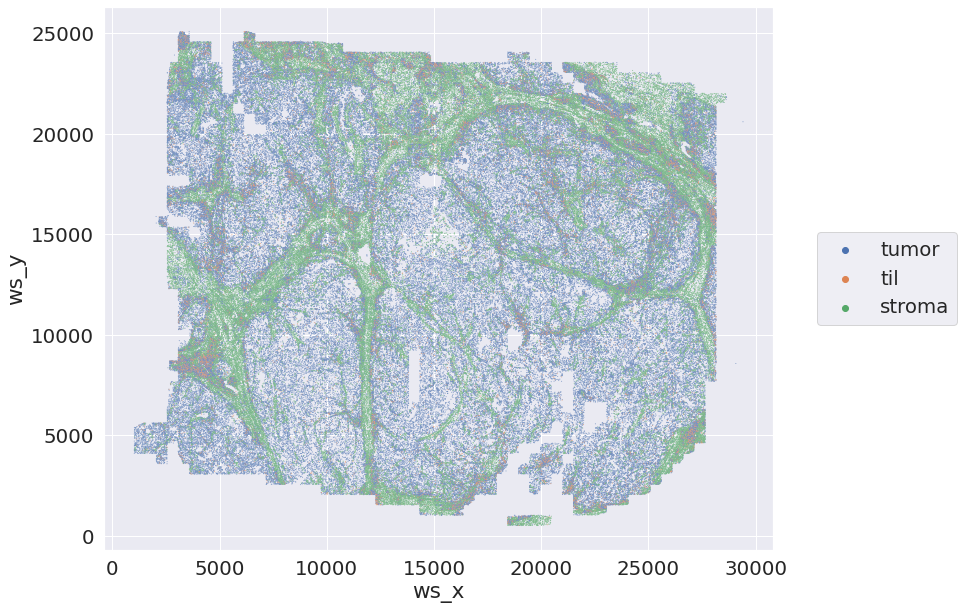

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


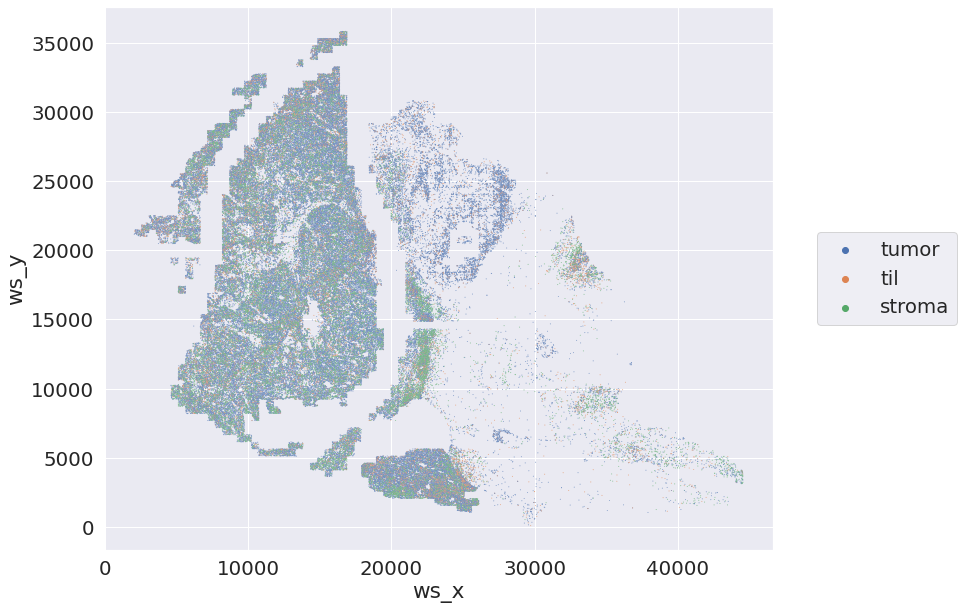

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


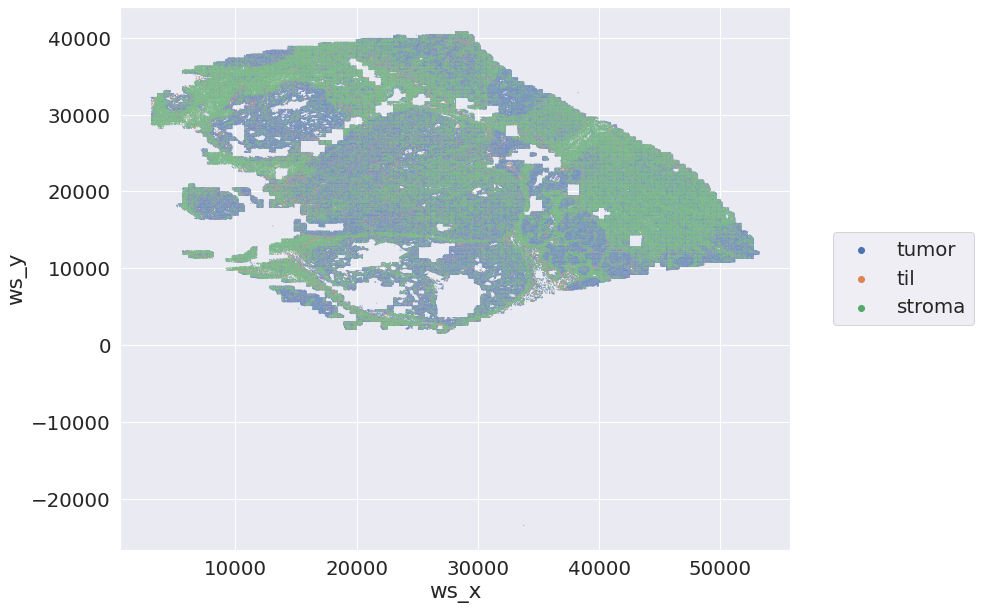

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


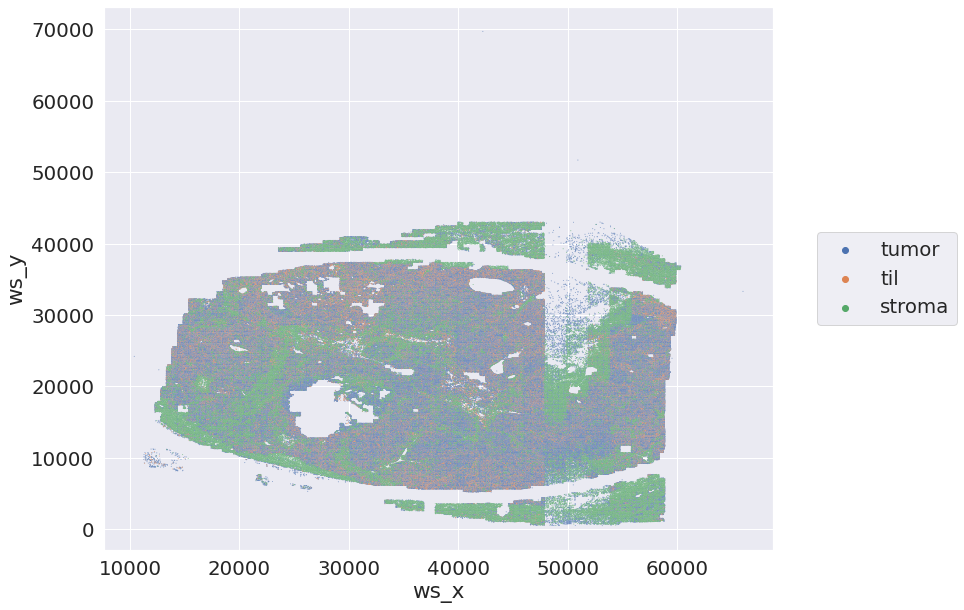

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


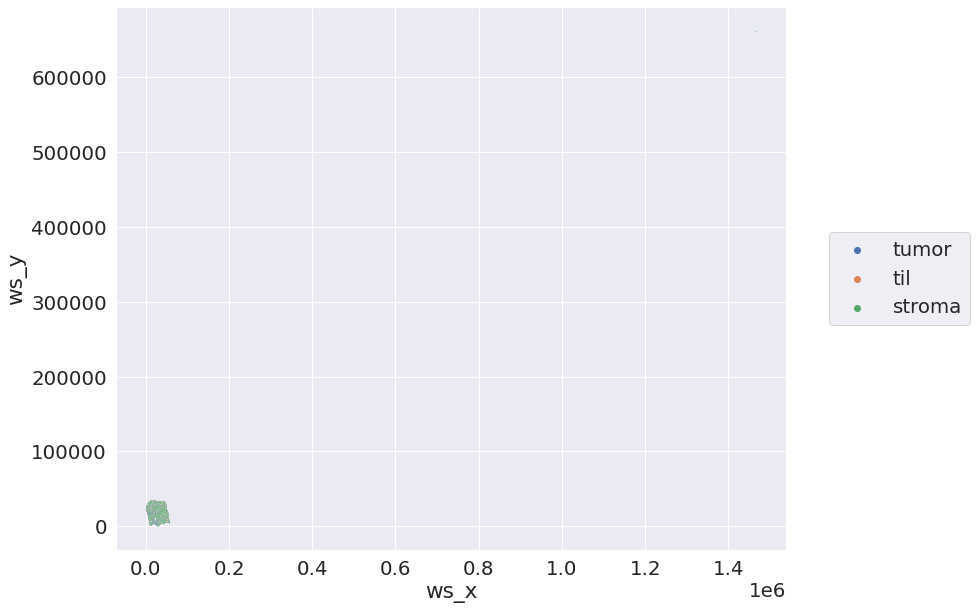

In [68]:
for unique_id in info_store.keys():
    set_rc(12,10, font_scale=1.8)
    g = sns.scatterplot('ws_x','ws_y',data=all_dfs.loc[unique_id].dropna(), hue='tissue_class', s=1, alpha=0.75)
    g.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
    plt.show()

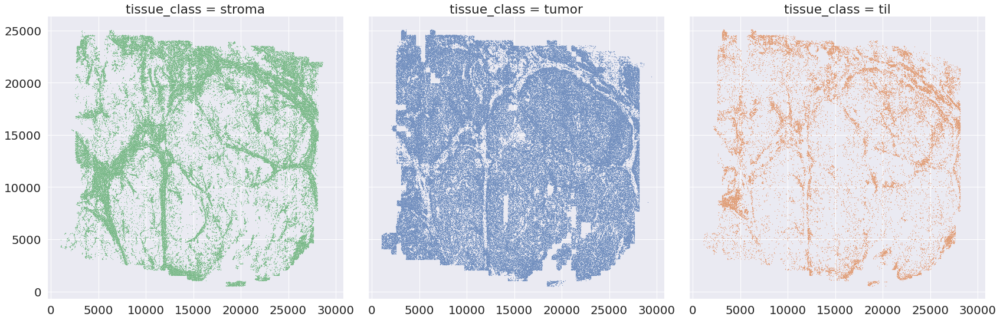

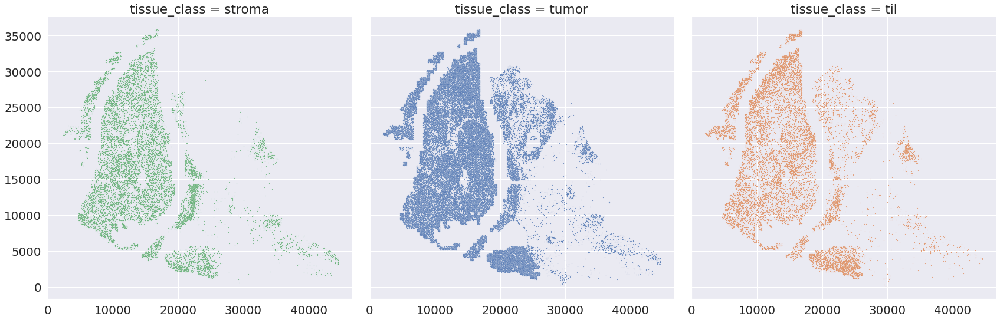

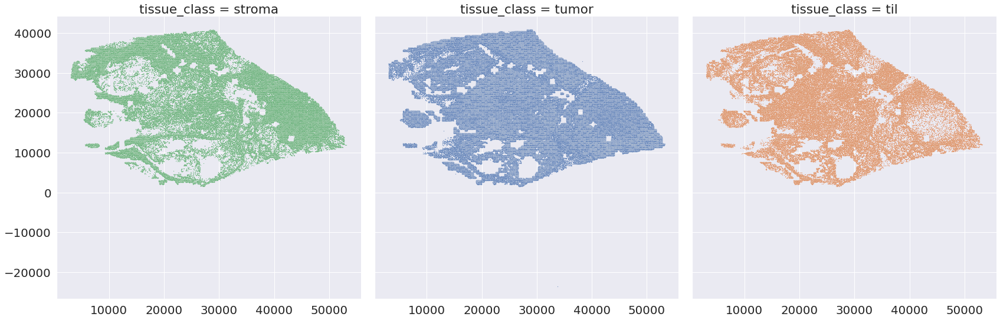

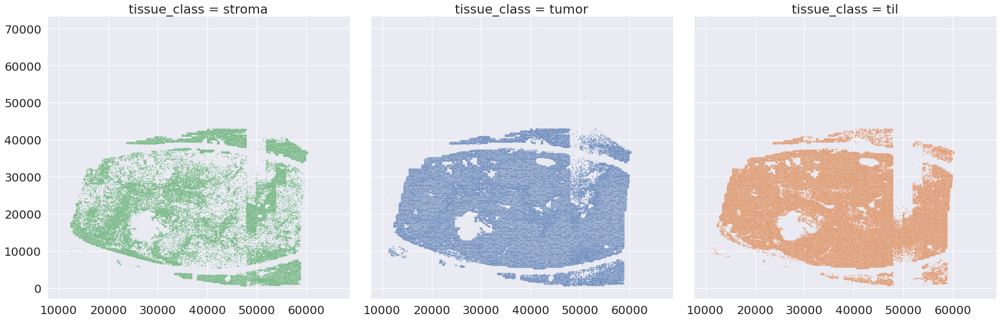

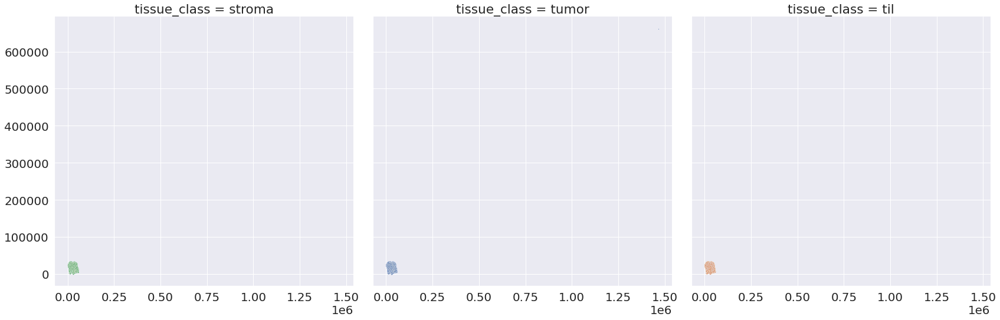

In [69]:
for unique_id in info_store.keys():
    set_rc(12,10, font_scale=1.8)
    g = sns.FacetGrid(data=all_dfs.loc[unique_id].dropna(), col='tissue_class',hue='tissue_class', height=8, col_order=['stroma','tumor','til'])
    g.map_dataframe(sns.scatterplot, x='ws_x',y='ws_y', s=1.5, alpha=0.8)

    plt.show()

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


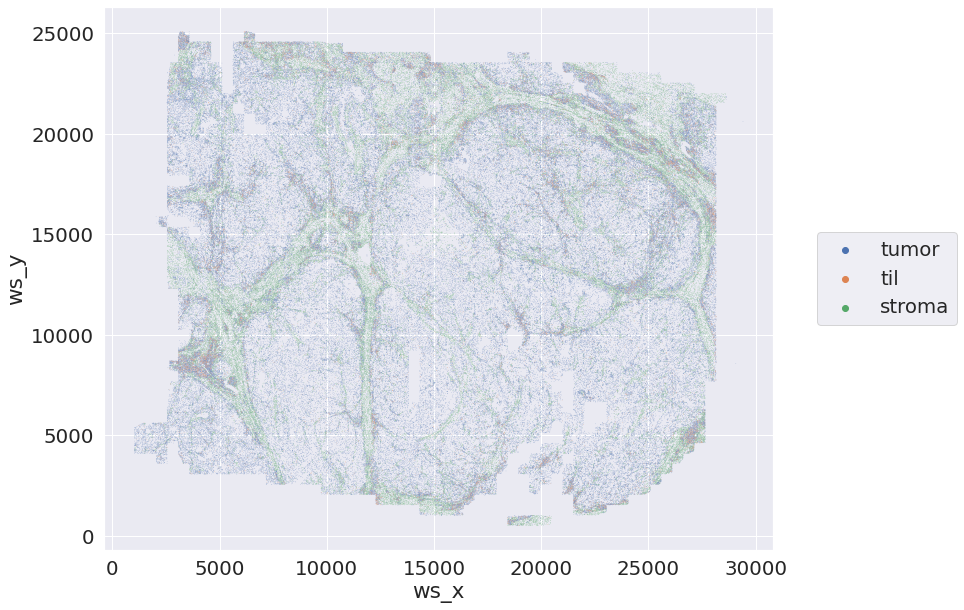

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


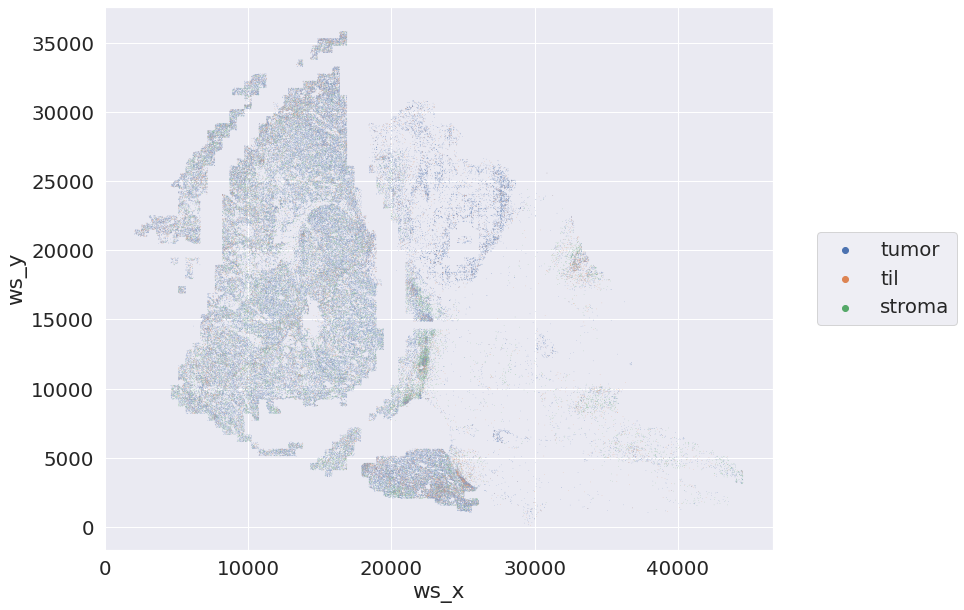

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


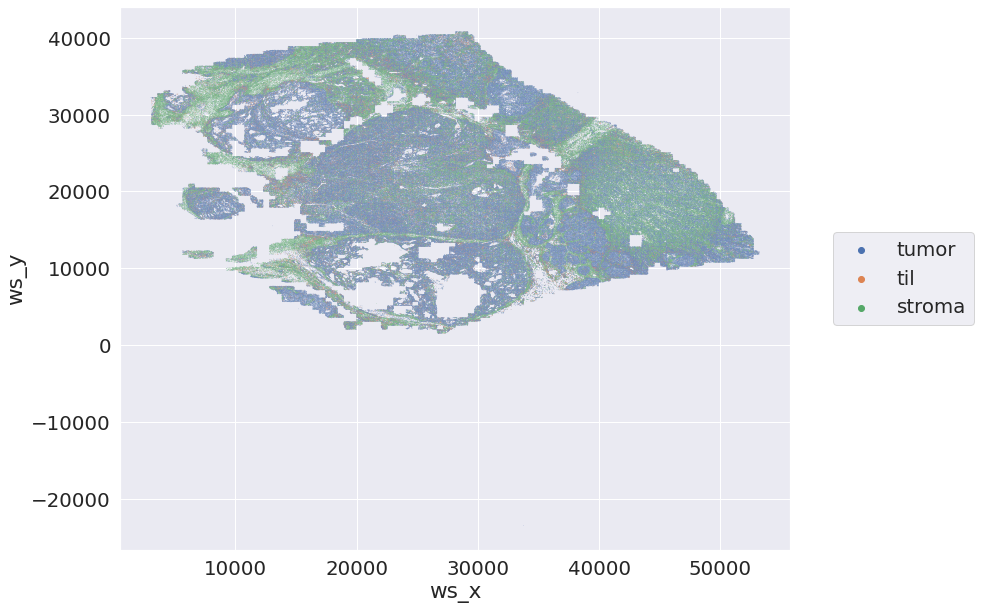

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


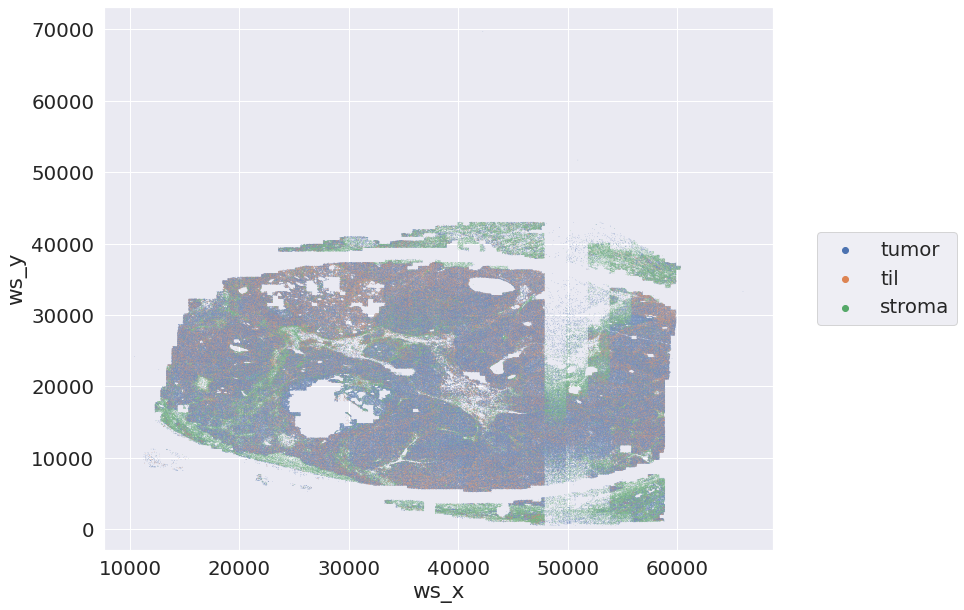

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


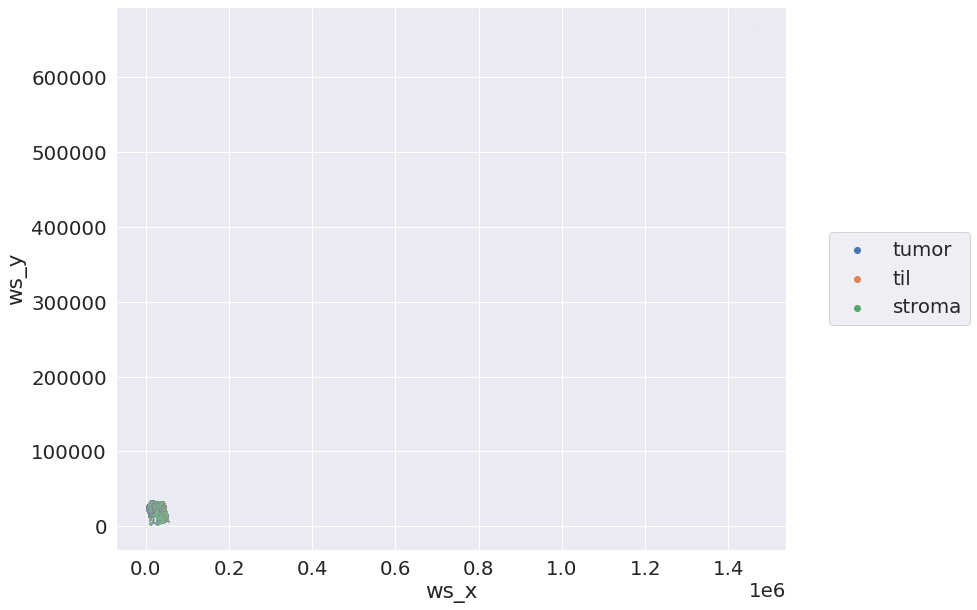

In [88]:
for unique_id in info_store.keys():
    set_rc(12,10, font_scale=1.8)
    g = sns.scatterplot('ws_x','ws_y',data=all_dfs.loc[unique_id].dropna(), hue='tissue_class', s=0.25, alpha=0.75)
    g.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
    plt.show()

In [89]:
info_store.keys()

dict_keys([1082196, 1079271, 1081576, 1092922, 1085914])

/opt/conda/envs/pathml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


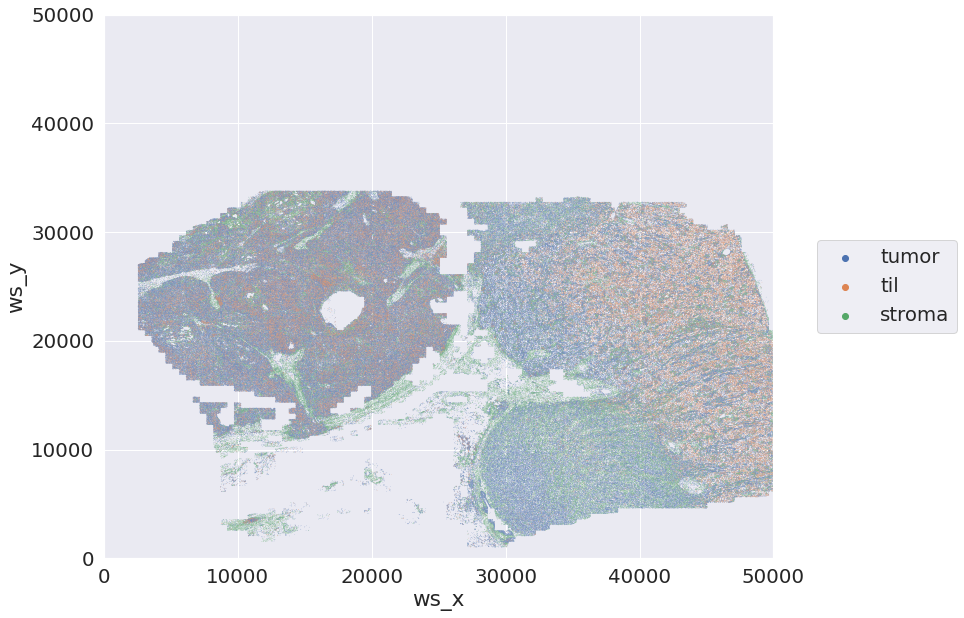

In [95]:
for unique_id in [1085914]:
    set_rc(12,10, font_scale=1.8)
    g = sns.scatterplot('ws_x','ws_y',data=all_dfs.loc[unique_id].dropna(), hue='tissue_class', s=0.25, alpha=0.75)
    g.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
    plt.xlim(0,50000)
    plt.ylim(0,50000)

    plt.show()

In [91]:
all_dfs.loc[unique_id].dropna().max()

cx               1450622.0
cy                628152.0
eccentricity           1.0
area               22311.0
roundness         9.865014
solidity               1.0
intensity       245.145081
prob_tumor           XXXXX
nc_bin                   2
nc_category          tumor
contour_idx            755
tissue_class         tumor
tx                     110
ty                      65
ws_x             1465470.0
ws_y              660920.0
dtype: object

In [122]:
np.isinf(all_dfs.loc[unique_id,['cx','cy']]).sum()

cx    0
cy    0
dtype: int64

In [124]:
np.isnan(all_dfs.loc[unique_id,['cx','cy']]).sum()

cx    17706
cy    17706
dtype: int64

In [125]:
np.isnan(all_dfs.loc[unique_id,['cx','cy']].dropna()).sum()

cx    0
cy    0
dtype: int64

In [126]:
all_dfs.loc[unique_id,['cx','cy']].describe()

,cx,cy
count,1.018792e+06,1.018792e+06
mean,-1.176321e+10,-1.137142e+11
std,4.895007e+13,1.147777e+14
min,-3.764376e+16,-1.158511e+17
25%,1.260000e+02,1.270000e+02
50%,2.560000e+02,2.560000e+02
75%,3.850000e+02,3.860000e+02
max,1.470674e+16,6.281520e+05


In [130]:
all_dfs.loc[all_dfs['cx'] > 520]

,cx,cy,eccentricity,area,roundness,solidity,intensity,prob_tumor,nc_bin,nc_category,contour_idx,tissue_class,tx,ty,ws_x,ws_y
file_id,,,,,,,,,,,,,,,,
1082196,633.0,153.0,0.992074,56.5,1.272225,0.974138,64.316666,XXXXX,1,tumor,210,tumor,48,25,25209.0,12953.0
1082196,583.0,108.0,0.948662,136.5,1.333127,0.968085,92.929413,XXXXX,0,background,18,tumor,29,33,15431.0,17004.0
1082196,770.0,227.0,0.998188,214.5,1.380993,0.930586,95.249161,XXXXX,2,stroma,13,stroma,44,45,23298.0,23267.0
1082196,529.0,369.0,0.919400,171.0,1.221585,0.952646,118.876663,XXXXX,1,tumor,34,tumor,26,24,13841.0,12657.0
1082196,524.0,184.0,0.916675,19.5,1.346060,0.886364,115.490799,XXXXX,0,background,19,tumor,22,41,11788.0,21176.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1085914,1430.0,745.0,0.998247,11.0,1.501800,0.956522,78.597000,XXXXX,1,tumor,45,tumor,77,10,40854.0,5865.0
1085914,1302.0,385.0,0.998103,35.5,1.376391,0.865854,88.286316,XXXXX,0,background,1,tumor,70,37,37142.0,19329.0
1085914,523.0,40.0,0.933713,109.5,1.228109,0.969027,58.376095,XXXXX,1,tumor,143,tumor,93,28,48139.0,14376.0


<AxesSubplot:>

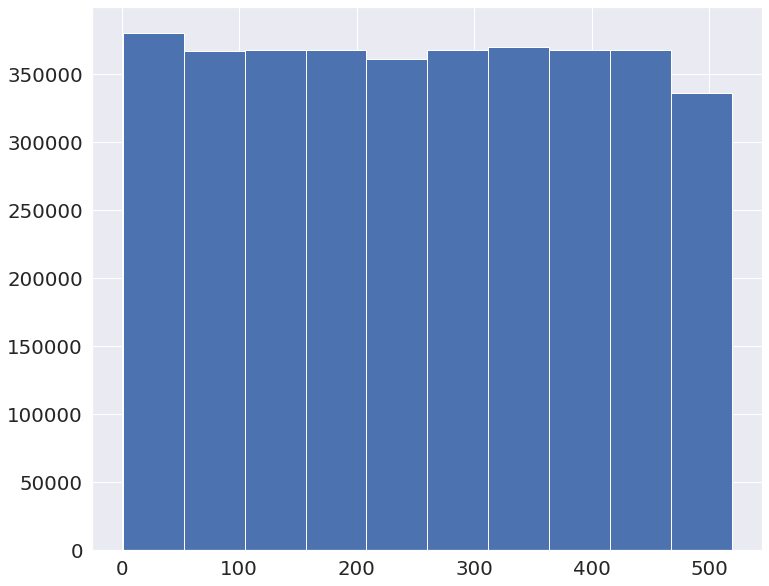

In [136]:
all_dfs.loc[(all_dfs['cx'] > 0) & (all_dfs['cx'] < 520)].cx.hist()

In [97]:
from glob import glob

In [102]:
glob('/mnt/disks/image_data/kidney/*/2017-07-27__22015*')

['/mnt/disks/image_data/kidney/images-20190724/2017-07-27__22015.svs',
 '/mnt/disks/image_data/kidney/20201117_tiles/2017-07-27__22015_files',
 '/mnt/disks/image_data/kidney/20201117_tiles/2017-07-27__22015.dzi']

In [100]:
anno.loc[anno.UNIQUE_SAMPLE_ID == 1092922]

,full_path,UNIQUE_SAMPLE_ID,image_name,Comment,UNIQUE_SAMPLE_ID_in_clinical_data,UNIQUE_SAMPLE_ID_in_mutations,Reason not in mutations,Reason not in clincal data,unique_sample_id,biopsy_site,...,PBRM1,KDM5C,file_idx,pre_treatment_biopsy,biopsy_rel_tx,biopsy_rel_tx_detailed,date_of_diagnosis_dt,date_of_metastasis_death_or_last_fu_dt,diff_date_mets_death_or_last_fu_dx,met_on_presentation
file_id,,,,,,,,,,,,,,,,,,,,,
2017-07-27__22015,/mnt/disks/image_data/2017-07-27__22015_files/...,1092922,2017-07-27__22015.svs,NaN,1092922.0,1092922.0,NaN,NaN,1092922.0,KIDNEY,...,1.0,0.0,308,True,pre_treatment,not_annotated,2017-07-10,2019-01-22,561.0,False


In [109]:
info_store.keys()

dict_keys([1082196, 1079271, 1081576, 1092922, 1085914])

In [ ]:
1092922

In [103]:
from openslide import OpenSlide

In [104]:
slide_obj = OpenSlide('/mnt/disks/image_data/kidney/images-20190724/2017-07-27__22015.svs')

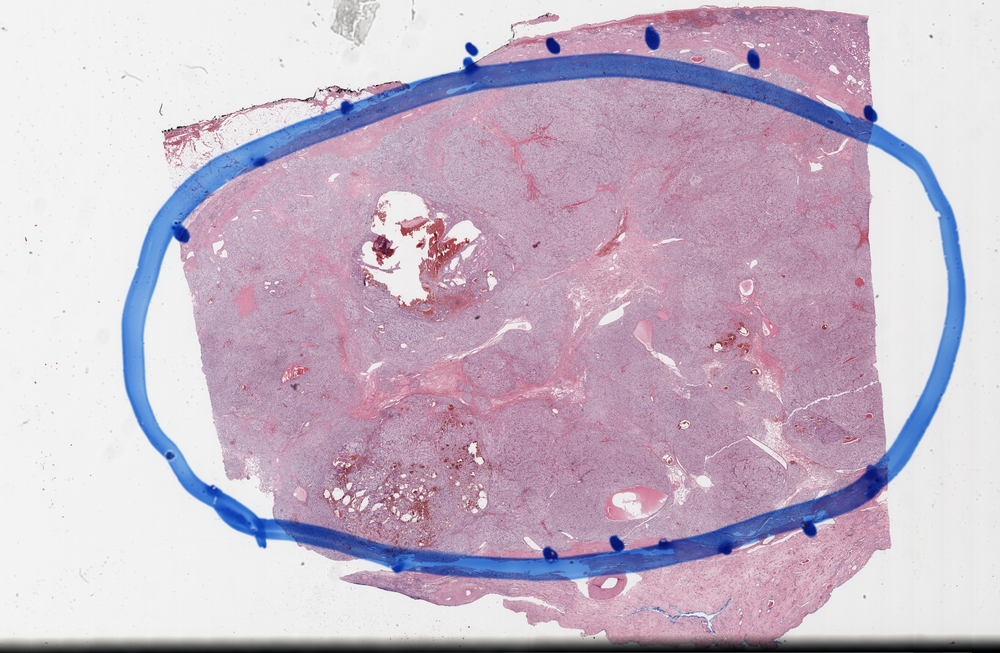

In [105]:
slide_obj.get_thumbnail((1000,1000))

- So it looks like there is some apparent artifact showing up with 1092922 that is likely not due to an SVS source issue

<AxesSubplot:xlabel='x', ylabel='y'>

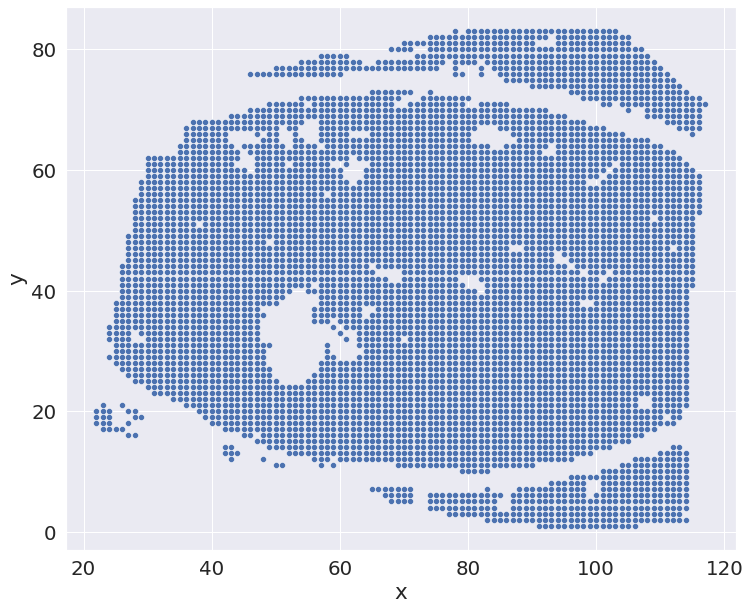

In [108]:
sns.scatterplot(x='x', y='y', data=eval_paths.loc[1092922])

- The tiles look.. fine? So maybe specific to the contour inference loop

In [110]:
anno.loc[anno.UNIQUE_SAMPLE_ID == 1082196]

,full_path,UNIQUE_SAMPLE_ID,image_name,Comment,UNIQUE_SAMPLE_ID_in_clinical_data,UNIQUE_SAMPLE_ID_in_mutations,Reason not in mutations,Reason not in clincal data,unique_sample_id,biopsy_site,...,PBRM1,KDM5C,file_idx,pre_treatment_biopsy,biopsy_rel_tx,biopsy_rel_tx_detailed,date_of_diagnosis_dt,date_of_metastasis_death_or_last_fu_dt,diff_date_mets_death_or_last_fu_dx,met_on_presentation
file_id,,,,,,,,,,,,,,,,,,,,,
2015-02-06__8345,/mnt/disks/image_data/2015-02-06__8345_files/2...,1082196,2015-02-06__8345.svs,NaN,1082196.0,1082196.0,NaN,NaN,1082196.0,KIDNEY,...,0.0,0.0,507,True,pre_treatment,pre_ici,2012-11-20,2012-11-20,0.0,True


In [111]:
glob('/mnt/disks/image_data/kidney/*/2015-02-06__8345*')

['/mnt/disks/image_data/kidney/images-20190724/2015-02-06__8345.svs',
 '/mnt/disks/image_data/kidney/20201117_tiles/2015-02-06__8345.dzi',
 '/mnt/disks/image_data/kidney/20201117_tiles/2015-02-06__8345_files']

In [112]:
slide_obj = OpenSlide('/mnt/disks/image_data/kidney/images-20190724/2015-02-06__8345.svs')

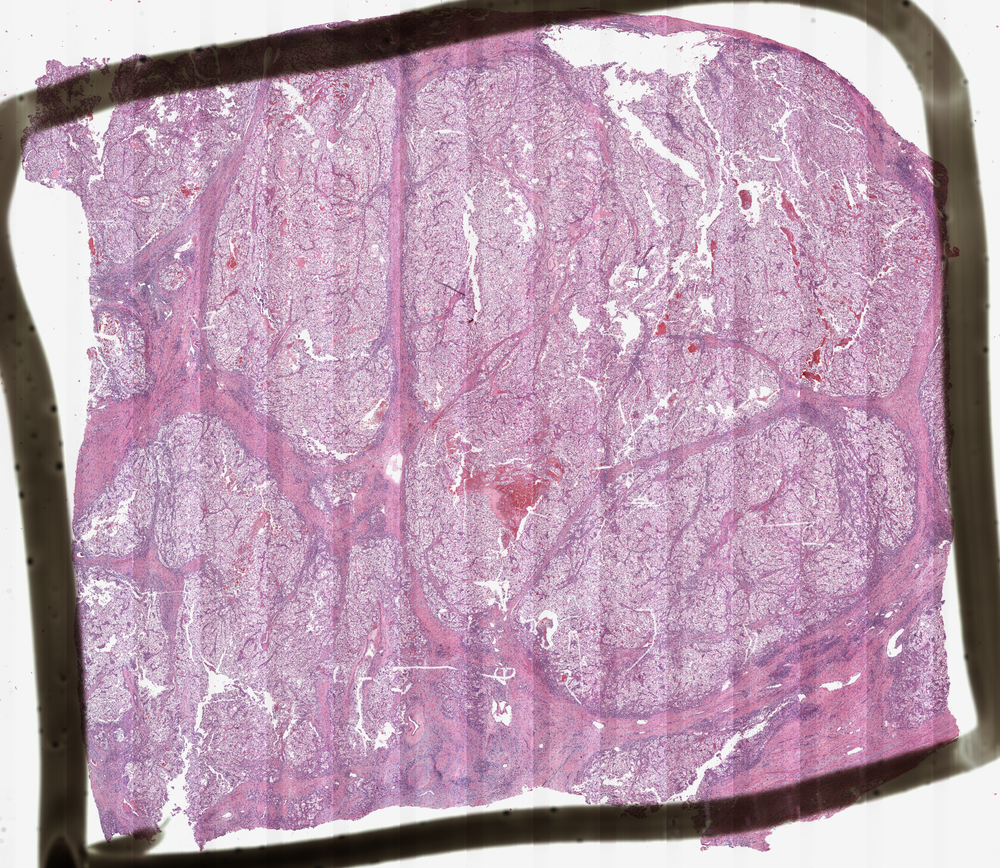

In [113]:
slide_obj.get_thumbnail((1000,1000))

<AxesSubplot:xlabel='x', ylabel='y'>

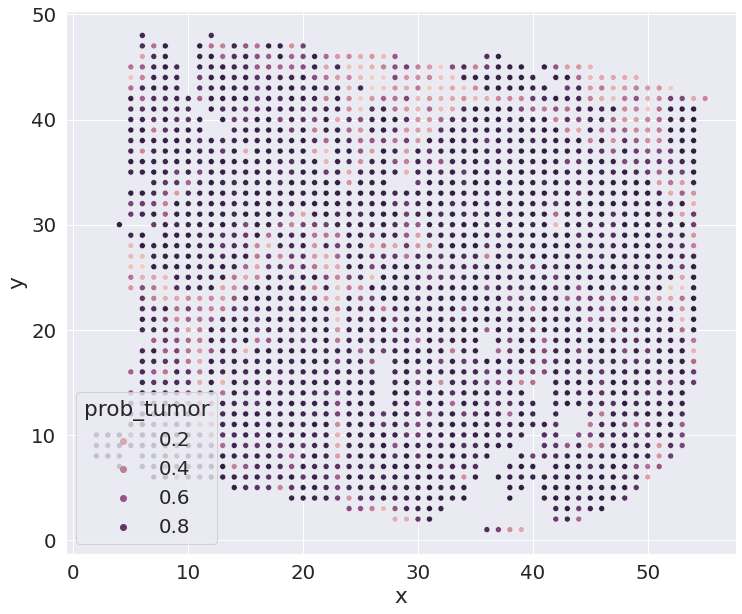

In [115]:
sns.scatterplot(x='x', y='y', data=eval_paths.loc[1082196], hue='prob_tumor')